# Computer Vision - P5

### **Carefully read the file `README.md` as well as the following instructions before start coding.**

## Delivery

Up to **1 point out of 10** will be penalized if the following requirements are not fulfilled:

- Implemented code should be commented.

- The questions introduced in the exercises must be answered.

- Add title to the figures to explain what is displayed.

- Comments need to be in **english**.

- The deliverable must be a file named **P5_Student1_Student2.zip** that includes:
    - The notebook P5_Student1_Student2.ipynb completed with the solutions to the exercises and their corresponding comments.
    - All the images used in this notebook.

**Deadline (Campus Virtual): December 11th, 23:00 h** 

==============================================================================================
## Practicum 5: Image search using textures


==============================================================================================



The exercises of this notebook will show how we can perform image similarity search using:

- Gaussian filters
- Descriptors based on texture and color

#### Problem we want to solve
- Given a query image **$x$** and a set of images **$X$** we would like to retreive the most similar to **$x$** images from  **$X$**.



 The function should return a feature vector obtained by averaging each filter response on the image.  

**Hint**: Note that since at this moment we are focusing on the texture, we will not use the color of the images.

## Looking at the images

In [21]:
%matplotlib inline

import time
import scipy
import numpy as np
import skimage
from skimage import filters
from skimage import io
import os
import math

from scipy import ndimage as nd

import matplotlib.pyplot as plt

In [2]:
path = "./images/texturesimages/buildings/"
building_images = [skimage.io.imread(path + f) for f in os.listdir(path)]

path = "./images/texturesimages/forest/"
forest_images = [skimage.io.imread(path + f) for f in os.listdir(path)]

path = "./images/texturesimages/sunset/"
sunset_images = [skimage.io.imread(path + f) for f in os.listdir(path)]

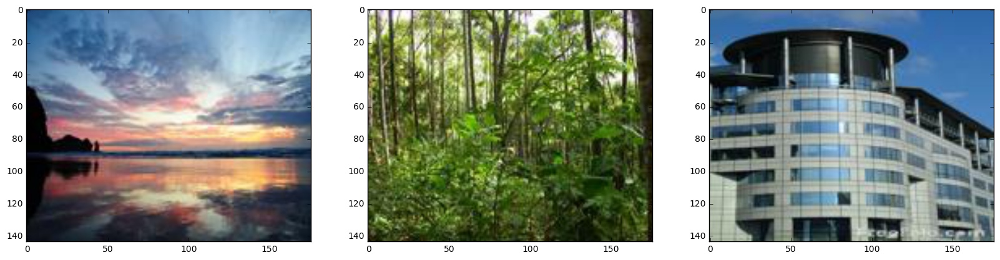

In [3]:
fig, ax= plt.subplots(ncols=3, nrows=1, figsize=(20,30))

ax[0].imshow(sunset_images[0])
ax[1].imshow(forest_images[0])
ax[2].imshow(building_images[0])
plt.show()

In [4]:
len(sunset_images), len(forest_images), len(sunset_images)

(30, 30, 30)

# Filter banks

We can apply a collection of multiple filters that we call a filter bank. Note that if we apply $D$ filters our feature vectors will be $D$ dimensional.

The following image shows a filter bank. In the filter bank we typically want filters to capture a combination of scales, orientations of different types of patterns. This particular filter bank is The Leung-Malik (LM) Filter Bank.

<img src="./images_notebook/filter_bank.png">


## Leung-Malik (LM) Filter Bank

In [5]:
import LM_filters

LM filters imported, the shape of the filter bank is:  (49, 49, 48)


In [6]:
filter_bank = LM_filters.makeLMfilters()
filter_bank.shape

(49, 49, 48)

### Plotting all filters

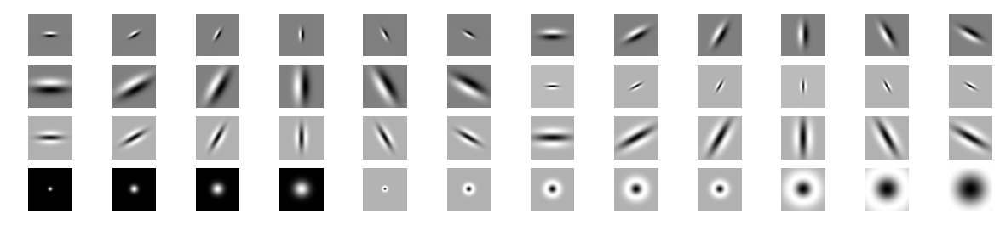

In [7]:
n_filters = filter_bank.shape[-1]

fig, ax = plt.subplots(ncols=12, nrows=4, figsize=(15,3))

k = 0
for i in range(4):
    for j in range(12):
        ax[i,j].imshow(filter_bank[:,:,k], cmap = 'gray')
        ax[i,j].axis("off")
        k = k + 1


## Exercise 5.1 Plot the convolved image by some of the filters


Make a function `visualize_features(im,  filter_bank, n_filters=5)` that recieves the `filter_bank`, an image `im` and an integer `n_filters`. 

The function  must make a plot of two rows containing in the first row, in position $k$, the image convolved by filter $k$. In the second row, in position $k$, the image of the k'th filter. The result for `n_filter=5` should look like 


<img src="./images/filters.png">


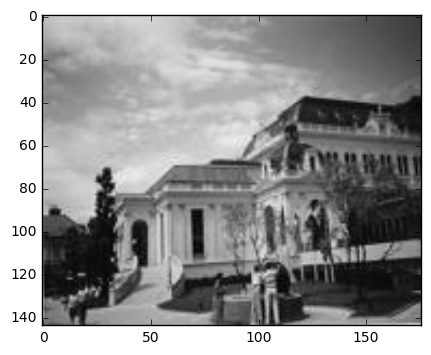

In [8]:
im = building_images[5]
im = skimage.color.rgb2gray(im)
plt.imshow(im, cmap="gray")
plt.show()

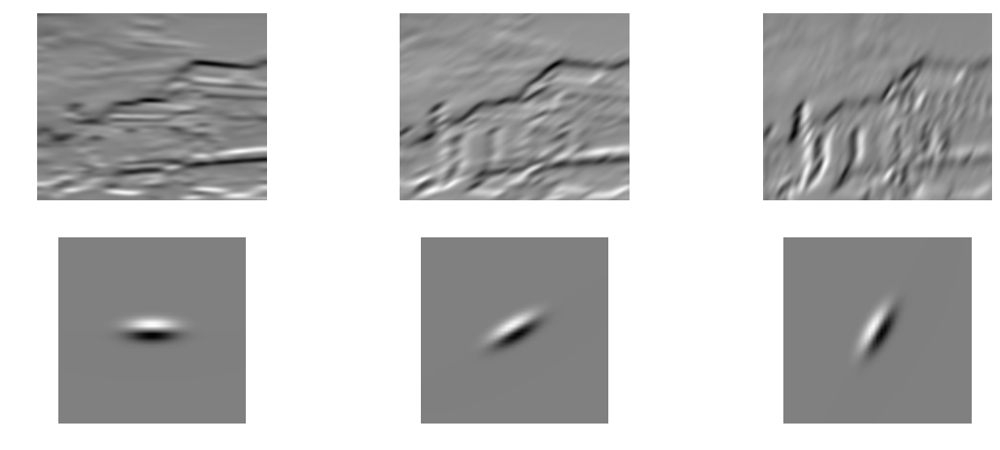

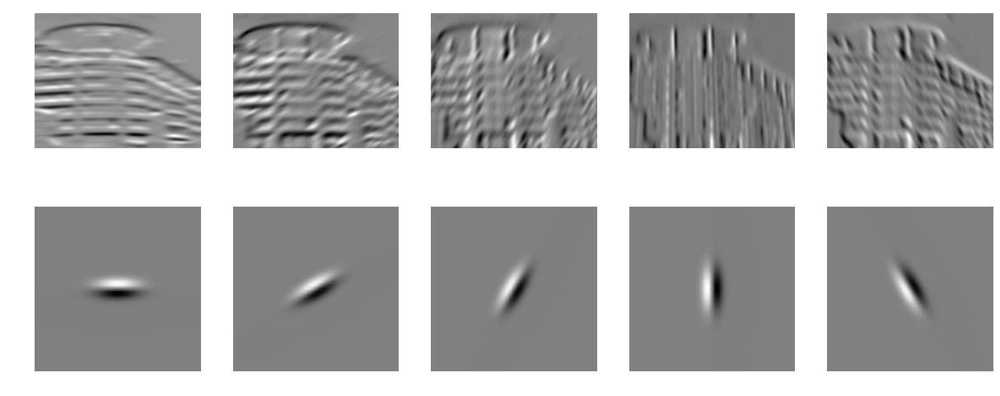

In [9]:
def visualize_features(im,  filter_bank, n_filters=5):
    fig, ax = plt.subplots(ncols=n_filters, nrows=2, figsize=(15,6))
    # complete this function
    if (n_filters > filter_bank.shape[-1]):
        n_filters = filter_bank.shape[-1]

    for j in range(n_filters):
        
        conv = nd.convolve(im, filter_bank[:,:,j] )
                                            
        ax[0,j].imshow(conv, cmap = 'gray')
        ax[0,j].axis("off")
        
        ax[1,j].imshow(filter_bank[:,:,j], cmap = 'gray')
        ax[1,j].axis("off")

visualize_features(im, filter_bank, 3)

im2 = skimage.color.rgb2gray(building_images[0])
visualize_features(im2, filter_bank)



## Exercise 5.2 Constructing a feature vector for a given image


Given $D$ filters from the filter bank and a single image `image`, make a function `features_from_filter_bank(image, filter_bank, n_filters)` that returns a feature vector of shape `n_filters`. The returned vector must contain at position $k$ the mean of the absolute value of the convolved image by filter $k$.

$$
\text{feat}(x) = \left( \text{mean}( |r_1|), \dots,\text{mean}(|r_D|) \right)
$$



In [10]:
%%time

#find the abs mean of the diferent n_filters convolutions and return them in features_for_im vector
def features_from_filter_bank(image, filter_bank, n_filters):
    ## Complete this function
    im_conv = np.zeros(image.shape)
    features_for_im = np.zeros(n_filters)
    
    for i in range(n_filters):
        im_conv = nd.convolve(image, filter_bank[:,:,i] )
        mean = np.mean( np.abs(im_conv) )
        features_for_im[i] = mean
    return features_for_im


im = skimage.color.rgb2gray(building_images[0])
features_for_im = features_from_filter_bank(im, filter_bank, n_filters)
print(features_for_im)

[  2.21469231e-02   1.58900275e-02   1.26171467e-02   1.58414955e-02
   1.43713338e-02   1.92448031e-02   1.28582071e-02   7.56540440e-03
   6.85812201e-03   9.07448773e-03   7.90332600e-03   9.53493042e-03
   7.36411067e-03   5.26016089e-03   4.96634658e-03   6.19999308e-03
   5.84671985e-03   6.38729935e-03   1.24974239e-02   6.55144477e-03
   5.29876846e-03   9.45092967e-03   6.28792070e-03   8.66085869e-03
   4.53164492e-03   1.97684101e-03   1.45035044e-03   2.79910185e-03
   1.72854145e-03   2.78964757e-03   1.81711728e-03   8.29927911e-04
   7.36324186e-04   1.26453262e-03   8.69156174e-04   1.14970474e-03
   1.58945706e+00   3.17891412e+00   4.76837112e+00   6.35764429e+00
   7.94728531e-01   3.97364265e-01   2.64909376e-01   1.98562727e-01
   2.64909376e-01   1.22053115e-01   3.87684911e-02   3.05265951e-03]
Wall time: 8.39 s


## Exercise 5.3 Constructing the matrix of the feature vectors for all images

Implement a function `get_class_Features(all_images, filter_bank)` that applies `features_from_filter_bank` to get a feature vector for each of the images in the union of the three datasets (forest, buildings, sunset). It must return a matrix containing at row $k$ feature vector for the input image $k$.


Wall time: 7min 49s

In [11]:
all_images = building_images + forest_images + sunset_images

[  2.21469231e-02   1.58900275e-02   1.26171467e-02   1.58414955e-02
   1.43713338e-02   1.92448031e-02   1.28582071e-02   7.56540440e-03
   6.85812201e-03   9.07448773e-03   7.90332600e-03   9.53493042e-03
   7.36411067e-03   5.26016089e-03   4.96634658e-03   6.19999308e-03
   5.84671985e-03   6.38729935e-03   1.24974239e-02   6.55144477e-03
   5.29876846e-03   9.45092967e-03   6.28792070e-03   8.66085869e-03
   4.53164492e-03   1.97684101e-03   1.45035044e-03   2.79910185e-03
   1.72854145e-03   2.78964757e-03   1.81711728e-03   8.29927911e-04
   7.36324186e-04   1.26453262e-03   8.69156174e-04   1.14970474e-03
   1.58945706e+00   3.17891412e+00   4.76837112e+00   6.35764429e+00
   7.94728531e-01   3.97364265e-01   2.64909376e-01   1.98562727e-01
   2.64909376e-01   1.22053115e-01   3.87684911e-02   3.05265951e-03]


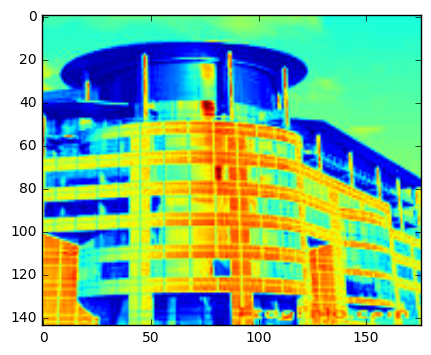

[  1.02325474e-02   9.38602050e-03   1.10111247e-02   1.79974524e-02
   1.17656345e-02   9.14105901e-03   5.76630894e-03   5.18027336e-03
   5.53269666e-03   8.54442972e-03   5.76556131e-03   5.23246662e-03
   4.30229345e-03   4.03787372e-03   3.78284427e-03   5.21577586e-03
   3.92285323e-03   3.97488851e-03   7.07215326e-03   4.61737854e-03
   5.01214987e-03   1.28396782e-02   5.42079801e-03   4.34823868e-03
   1.66250039e-03   1.09327377e-03   1.21318224e-03   3.15662306e-03
   1.36735511e-03   1.05324315e-03   8.12817654e-04   6.07855636e-04
   6.55114196e-04   1.30036608e-03   6.79849933e-04   6.40524492e-04
   2.15946377e+00   4.31892754e+00   6.47839122e+00   8.63760516e+00
   1.07973188e+00   5.39865942e-01   3.59910446e-01   2.69770745e-01
   3.59910446e-01   1.65823467e-01   5.26715405e-02   3.32465602e-03]


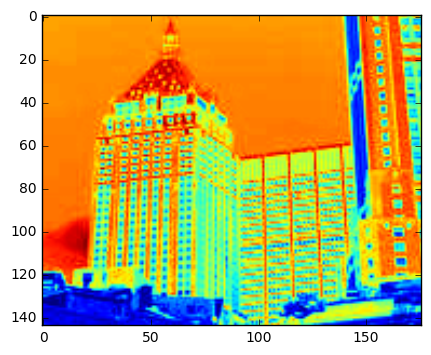

[  1.32827217e-02   1.10235572e-02   1.01401772e-02   1.09211397e-02
   9.55277334e-03   1.02643437e-02   7.17724473e-03   6.19487052e-03
   6.37478594e-03   7.07842706e-03   5.90924271e-03   5.52512895e-03
   5.07348017e-03   4.88294520e-03   4.99998481e-03   5.55351179e-03
   4.48828070e-03   4.29357854e-03   8.21425951e-03   5.56806782e-03
   5.08598793e-03   5.91045167e-03   4.44769598e-03   5.11558671e-03
   2.10142514e-03   1.37651657e-03   1.31030596e-03   1.67911322e-03
   1.27137161e-03   1.33194622e-03   8.28727322e-04   6.57761301e-04
   7.15207028e-04   8.82387127e-04   6.62290364e-04   6.55816129e-04
   1.15660585e+00   2.31321170e+00   3.46981750e+00   4.62628954e+00
   5.78302924e-01   2.89151462e-01   1.92767544e-01   1.44488843e-01
   1.92767544e-01   8.88148225e-02   2.82108052e-02   2.47538359e-03]


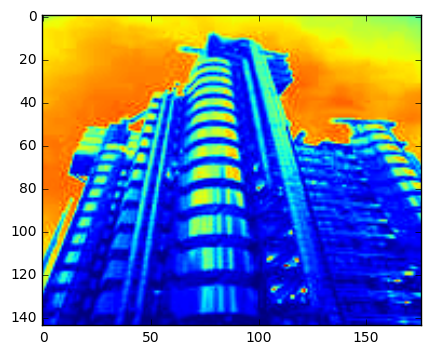

[  1.08576130e-02   9.68825024e-03   9.52879849e-03   1.06258242e-02
   1.02497340e-02   1.01668062e-02   7.50463334e-03   7.04167121e-03
   6.58648405e-03   7.48401061e-03   7.25441457e-03   6.92462211e-03
   6.29418792e-03   6.09270479e-03   5.18546065e-03   5.65379324e-03
   5.51129417e-03   5.78659029e-03   5.09095513e-03   4.00619807e-03
   3.56354776e-03   5.09334065e-03   4.63000824e-03   4.12075939e-03
   1.66094092e-03   1.39002067e-03   1.23570944e-03   1.85421190e-03
   1.64346396e-03   1.25933678e-03   8.58686632e-04   7.50513379e-04
   7.38097627e-04   1.01136548e-03   9.65634709e-04   6.81527240e-04
   1.67440036e+00   3.34880072e+00   5.02320101e+00   6.69740766e+00
   8.37200181e-01   4.18600090e-01   2.79066585e-01   2.09174258e-01
   2.79066585e-01   1.28575842e-01   4.08403455e-02   3.15631775e-03]


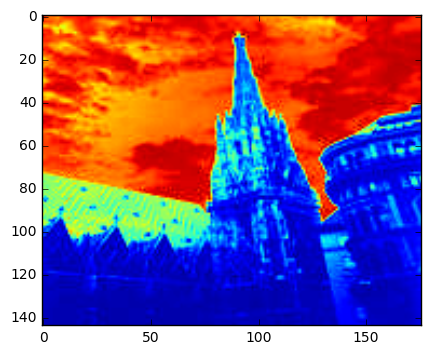

[  1.92434804e-02   1.84577190e-02   1.36469423e-02   1.41770901e-02
   1.26183406e-02   1.38155314e-02   1.10787254e-02   1.08187817e-02
   7.41900982e-03   7.25681877e-03   6.90518304e-03   7.81911226e-03
   7.64947253e-03   7.56694144e-03   5.25038348e-03   5.34042788e-03
   5.01341768e-03   5.86763168e-03   1.04044703e-02   8.87623234e-03
   6.33067553e-03   9.30100248e-03   6.37587442e-03   5.98932593e-03
   3.06498609e-03   2.70040308e-03   1.59199144e-03   2.01875747e-03
   1.54440933e-03   1.68995550e-03   1.40425087e-03   1.37382188e-03
   7.78348630e-04   9.23908161e-04   7.24886882e-04   8.48170158e-04
   1.69009476e+00   3.38018953e+00   5.07028422e+00   6.76018346e+00
   8.45047382e-01   4.22523691e-01   2.81682318e-01   2.11134880e-01
   2.81682318e-01   1.29781002e-01   4.12231481e-02   2.84524746e-03]


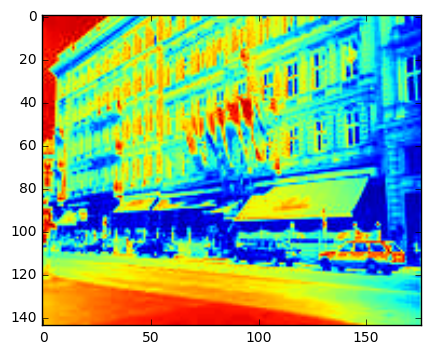

[  1.62030482e-02   1.43999053e-02   1.24726611e-02   1.31483792e-02
   1.20786030e-02   1.30682696e-02   1.01990972e-02   8.94845017e-03
   7.30946410e-03   7.87945732e-03   6.88145216e-03   7.77044534e-03
   7.55220787e-03   6.61677143e-03   5.21378583e-03   5.42797215e-03
   4.86198191e-03   5.46841146e-03   8.67123834e-03   6.49626989e-03
   5.57003469e-03   7.25250926e-03   5.30276137e-03   5.44133026e-03
   2.77530525e-03   2.06115621e-03   1.62875909e-03   2.14559326e-03
   1.55156232e-03   1.70454155e-03   1.43683850e-03   1.07367995e-03
   8.19145476e-04   1.01887412e-03   8.08873198e-04   8.60980505e-04
   1.64094380e+00   3.28188760e+00   4.92283133e+00   6.56358528e+00
   8.20471899e-01   4.10235950e-01   2.73490494e-01   2.04994701e-01
   2.73490494e-01   1.26006740e-01   4.00276415e-02   3.08835570e-03]


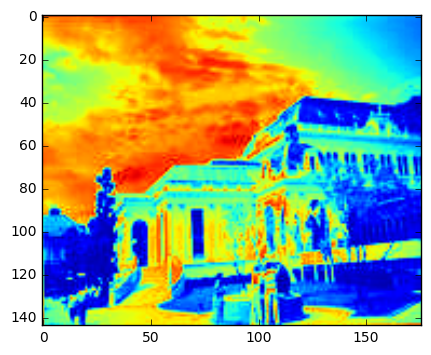

[  1.45244165e-02   1.22833944e-02   1.12513852e-02   1.24842666e-02
   1.17108862e-02   1.25952012e-02   1.00292250e-02   7.76806633e-03
   6.66960937e-03   7.22153055e-03   6.62019769e-03   8.01281256e-03
   7.25195522e-03   5.57419986e-03   4.85014588e-03   5.06528411e-03
   4.72426282e-03   5.45701151e-03   7.59571813e-03   4.50323541e-03
   4.51673316e-03   6.99515184e-03   4.74587718e-03   4.93192548e-03
   2.60355961e-03   1.54577452e-03   1.44546125e-03   2.10809389e-03
   1.51831938e-03   1.75916943e-03   1.45508808e-03   9.10372747e-04
   7.77450326e-04   9.75985628e-04   7.69020756e-04   9.54175446e-04
   1.75895879e+00   3.51791759e+00   5.27687631e+00   7.03563161e+00
   8.79479397e-01   4.39739699e-01   2.93159650e-01   2.19737710e-01
   2.93159650e-01   1.35069015e-01   4.29028126e-02   3.27172245e-03]


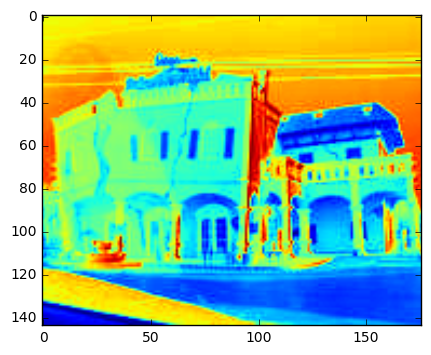

[  1.59578993e-02   1.56678747e-02   1.50942896e-02   1.53839062e-02
   1.51158214e-02   1.42562476e-02   1.02515814e-02   1.06783099e-02
   9.83187644e-03   9.41667692e-03   9.71204082e-03   9.20544967e-03
   8.22195255e-03   8.87140009e-03   7.97131219e-03   6.90237237e-03
   7.25205461e-03   7.50202965e-03   8.65863589e-03   7.13764377e-03
   6.34917642e-03   7.79608710e-03   7.22327409e-03   5.67187063e-03
   2.65416609e-03   2.12141565e-03   1.99679880e-03   2.48895369e-03
   2.36535733e-03   1.72665240e-03   1.35480289e-03   1.17194170e-03
   1.08687845e-03   1.21738666e-03   1.23433320e-03   9.34527825e-04
   1.77688533e+00   3.55377066e+00   5.33065591e+00   7.10733567e+00
   8.88442664e-01   4.44221332e-01   2.96147404e-01   2.21977180e-01
   2.96147404e-01   1.36445579e-01   4.33400591e-02   3.71574942e-03]


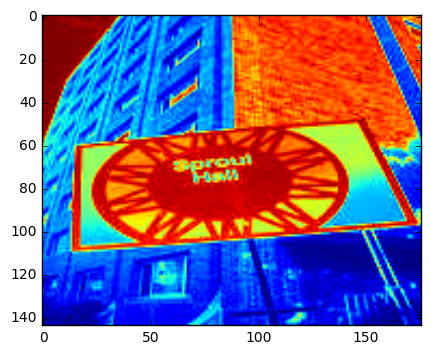

[  1.62286676e-02   1.35901597e-02   1.14596829e-02   1.00844583e-02
   1.17004948e-02   1.42917709e-02   1.14104939e-02   9.45004454e-03
   7.74280416e-03   6.43575894e-03   7.74801556e-03   9.83768619e-03
   8.98472101e-03   7.98605857e-03   5.50702994e-03   4.63072251e-03
   5.57776605e-03   8.17483242e-03   8.59950197e-03   4.83207315e-03
   4.01708053e-03   5.31446569e-03   4.21488106e-03   5.08764592e-03
   2.91301226e-03   1.73231384e-03   1.35457053e-03   1.81203384e-03
   1.46694001e-03   1.84939897e-03   1.62922253e-03   9.88084938e-04
   7.89096450e-04   9.65001026e-04   8.36635904e-04   1.03563922e-03
   1.77916924e+00   3.55833847e+00   5.33750763e+00   7.11647104e+00
   8.89584618e-01   4.44792309e-01   2.96528056e-01   2.22262497e-01
   2.96528056e-01   1.36620959e-01   4.33962258e-02   3.62915093e-03]


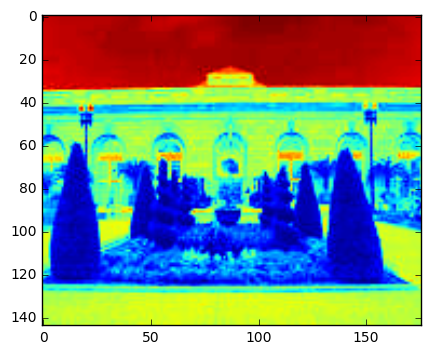

[  1.14058599e-02   1.06549906e-02   1.03068936e-02   1.06543499e-02
   1.00445153e-02   1.02737708e-02   8.11171119e-03   7.06050260e-03
   6.78487056e-03   6.75507938e-03   6.39164115e-03   6.91239153e-03
   6.15817531e-03   5.62996978e-03   5.41951071e-03   5.04596480e-03
   5.11341574e-03   5.70289590e-03   5.84423218e-03   3.97415524e-03
   4.03541733e-03   5.89518102e-03   4.06046405e-03   3.85753933e-03
   2.18902237e-03   1.45801715e-03   1.41492861e-03   2.03008181e-03
   1.34856065e-03   1.34321601e-03   1.12914786e-03   8.37864731e-04
   8.23792863e-04   9.51120255e-04   7.37605548e-04   7.88444424e-04
   2.13438278e+00   4.26876557e+00   6.40314826e+00   8.53728412e+00
   1.06719139e+00   5.33595696e-01   3.55730284e-01   2.66637506e-01
   3.55730284e-01   1.63897518e-01   5.20597895e-02   3.39192619e-03]


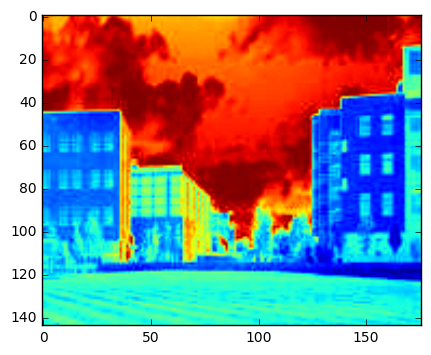

[  1.16393802e-02   1.18584260e-02   1.48278266e-02   1.92035453e-02
   1.55624273e-02   1.25388270e-02   6.80357342e-03   6.77995494e-03
   8.28221788e-03   1.11961151e-02   9.15807808e-03   6.86468398e-03
   4.92020806e-03   4.91632868e-03   5.48849853e-03   7.61866193e-03
   6.36822585e-03   4.60554558e-03   6.73982699e-03   5.13664088e-03
   6.36399867e-03   1.15271017e-02   6.84140975e-03   5.31858101e-03
   1.73877983e-03   1.49381946e-03   2.01565773e-03   3.40622832e-03
   2.27789593e-03   1.58600496e-03   8.13265901e-04   7.66354279e-04
   1.02722086e-03   1.64574089e-03   1.22976694e-03   7.93060562e-04
   2.05848418e+00   4.11696835e+00   6.17545244e+00   8.23369847e+00
   1.02924209e+00   5.14621044e-01   3.43080522e-01   2.57155881e-01
   3.43080522e-01   1.58069326e-01   5.02085444e-02   3.35900349e-03]


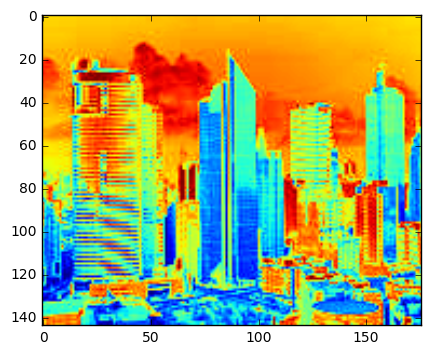

[  2.27477963e-02   1.44737375e-02   1.05258970e-02   1.06517191e-02
   1.31402307e-02   2.07901149e-02   1.37073541e-02   7.67197385e-03
   7.06356192e-03   7.49856090e-03   7.26270043e-03   1.12680961e-02
   8.67426194e-03   5.43329721e-03   5.29131741e-03   5.94648710e-03
   5.14295927e-03   6.94340634e-03   1.20769901e-02   4.70907784e-03
   3.46303608e-03   5.52372698e-03   4.63493491e-03   9.20235764e-03
   4.53586835e-03   1.43878491e-03   1.32222813e-03   2.06080017e-03
   1.52170511e-03   3.07114348e-03   2.06506282e-03   7.38435218e-04
   7.60341428e-04   1.11512229e-03   8.68125065e-04   1.43070449e-03
   1.26823655e+00   2.53647309e+00   3.80470958e+00   5.07279940e+00
   6.34118273e-01   3.17059136e-01   2.11372650e-01   1.58434294e-01
   2.11372650e-01   9.73868529e-02   3.09335926e-02   3.00803290e-03]


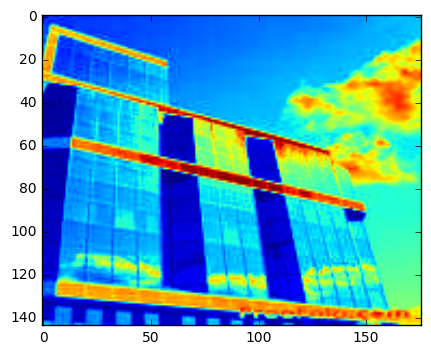

[  9.57503449e-03   1.17291746e-02   1.73952798e-02   2.32270255e-02
   1.70762458e-02   1.14143052e-02   6.27306445e-03   6.93027098e-03
   1.07368288e-02   1.48174109e-02   9.88379111e-03   6.72370330e-03
   4.93238274e-03   5.31486249e-03   7.52418577e-03   1.02741986e-02
   6.91695703e-03   5.26939578e-03   4.98257846e-03   4.29740775e-03
   6.80188406e-03   1.34289803e-02   6.88049312e-03   4.29262194e-03
   1.57741231e-03   1.35176444e-03   2.33313062e-03   4.76874449e-03
   2.21671392e-03   1.22491225e-03   7.79095055e-04   7.11504030e-04
   1.26529529e-03   2.26807835e-03   1.04625808e-03   6.30956015e-04
   1.46531596e+00   2.93063191e+00   4.39594780e+00   5.86109424e+00
   7.32657978e-01   3.66328989e-01   2.44219202e-01   1.83054415e-01
   2.44219202e-01   1.12520421e-01   3.57405620e-02   3.02691015e-03]


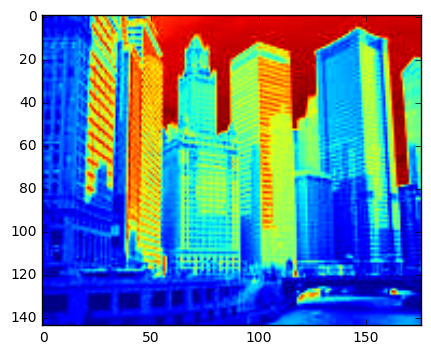

[  8.43960510e-03   8.19404898e-03   9.41660413e-03   1.14431428e-02
   9.62205663e-03   8.32988975e-03   5.56229239e-03   5.54845262e-03
   6.21338100e-03   7.25361416e-03   6.16523223e-03   5.61656076e-03
   4.37943238e-03   4.52414602e-03   4.84583477e-03   5.32617668e-03
   4.70591917e-03   4.30892251e-03   4.44166924e-03   3.68283066e-03
   3.89442467e-03   6.38819909e-03   3.79763947e-03   3.05663190e-03
   1.26776370e-03   1.03603945e-03   1.27127900e-03   2.04703612e-03
   1.18885378e-03   9.89292710e-04   6.37896971e-04   6.68658187e-04
   7.49257007e-04   9.65809211e-04   7.29546252e-04   6.27923479e-04
   2.28328090e+00   4.56656180e+00   6.84984261e+00   9.13285936e+00
   1.14164045e+00   5.70820226e-01   3.80546624e-01   2.85238585e-01
   3.80546624e-01   1.75331284e-01   5.56915676e-02   3.36140102e-03]


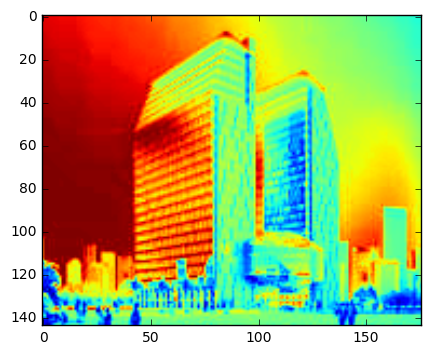

[  1.47781038e-02   1.35569610e-02   1.45943650e-02   1.64424838e-02
   1.49052857e-02   1.33865981e-02   9.08605667e-03   8.15343268e-03
   8.67055511e-03   1.03387697e-02   9.06447523e-03   8.06033006e-03
   6.64656654e-03   5.77837232e-03   6.24402907e-03   8.06445395e-03
   6.65829254e-03   5.71477787e-03   8.05549521e-03   5.73589587e-03
   6.80282834e-03   9.76361337e-03   6.99713146e-03   5.34547587e-03
   2.45416578e-03   1.84989951e-03   1.79692614e-03   2.88780836e-03
   1.88798960e-03   1.61786780e-03   1.21823794e-03   9.46084208e-04
   9.39360647e-04   1.48986420e-03   1.02446853e-03   8.43444652e-04
   1.45365974e+00   2.90731948e+00   4.36097916e+00   5.81447073e+00
   7.26829870e-01   3.63414935e-01   2.42276501e-01   1.81598264e-01
   2.42276501e-01   1.11625349e-01   3.54562549e-02   3.48591907e-03]


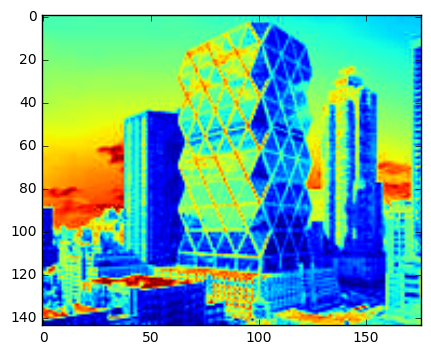

[  1.13082359e-02   1.01018148e-02   9.31208133e-03   9.98177189e-03
   1.05963076e-02   1.06119703e-02   7.20624891e-03   5.86206264e-03
   5.41503309e-03   6.34738552e-03   6.20814147e-03   6.41896081e-03
   5.19350570e-03   4.44280740e-03   3.74411975e-03   4.35068876e-03
   3.95983476e-03   4.67651443e-03   5.47879493e-03   4.30168215e-03
   4.34242840e-03   5.27973144e-03   5.09892042e-03   4.15334928e-03
   1.70071570e-03   1.17095048e-03   1.17756357e-03   1.78059870e-03
   1.52899479e-03   1.39084333e-03   8.21885813e-04   6.05483728e-04
   6.56834828e-04   9.49511521e-04   8.15559647e-04   7.45027090e-04
   1.57879239e+00   3.15758478e+00   4.73637710e+00   6.31498684e+00
   7.89396194e-01   3.94698097e-01   2.63131931e-01   1.97230444e-01
   2.63131931e-01   1.21234184e-01   3.85083688e-02   2.46864175e-03]


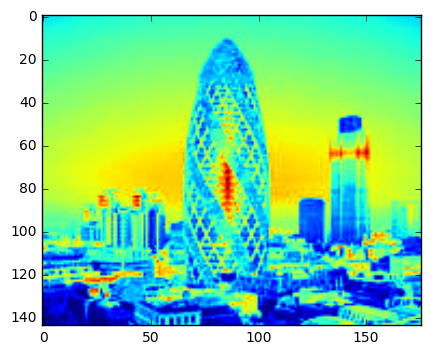

[  1.16879405e-02   1.16884525e-02   1.49991673e-02   1.93533608e-02
   1.46744308e-02   1.17297740e-02   7.65936701e-03   6.61900216e-03
   8.38643658e-03   1.12251832e-02   8.38899247e-03   6.87065414e-03
   5.55341459e-03   4.47143354e-03   5.74095867e-03   7.40108291e-03
   5.73849215e-03   4.80179021e-03   6.60552310e-03   4.47163013e-03
   6.43332061e-03   1.15286400e-02   5.99615618e-03   4.61865209e-03
   2.02293124e-03   1.46545523e-03   2.00532548e-03   3.49070606e-03
   1.94188763e-03   1.49533344e-03   1.10744070e-03   7.54987307e-04
   1.03077558e-03   1.63328929e-03   1.03859233e-03   8.33970842e-04
   2.27773857e+00   4.55547714e+00   6.83321561e+00   9.11069066e+00
   1.13886928e+00   5.69434642e-01   3.79622902e-01   2.84546209e-01
   3.79622902e-01   1.74905692e-01   5.55563844e-02   3.71435354e-03]


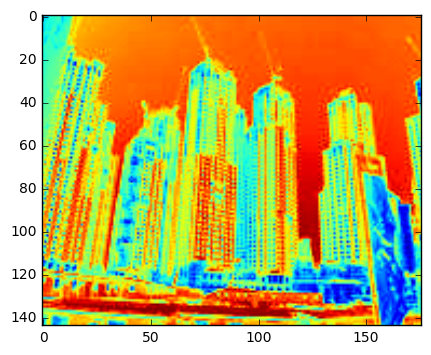

[  1.55006805e-02   1.47751146e-02   1.58649824e-02   1.88811257e-02
   1.72906133e-02   1.56633041e-02   8.86113141e-03   8.22921579e-03
   8.74236122e-03   1.05613421e-02   9.58319511e-03   8.57498095e-03
   6.21045571e-03   5.59545824e-03   5.67353144e-03   6.89456140e-03
   6.19211035e-03   5.74269431e-03   8.05084590e-03   6.74016464e-03
   7.10268717e-03   1.11711782e-02   8.00418288e-03   7.21971098e-03
   2.32204889e-03   2.01523775e-03   2.18732651e-03   3.23692918e-03
   2.56730849e-03   2.10531155e-03   1.10289935e-03   9.59315340e-04
   1.08987476e-03   1.51433848e-03   1.26303386e-03   9.91994033e-04
   1.73682014e+00   3.47364027e+00   5.21046034e+00   6.94707954e+00
   8.68410068e-01   4.34205034e-01   2.89469876e-01   2.16972041e-01
   2.89469876e-01   1.33369006e-01   4.23628280e-02   3.29869899e-03]


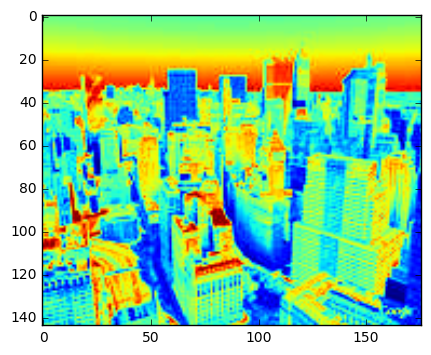

[  2.14675427e-02   1.74493007e-02   1.76593068e-02   1.79012367e-02
   1.47914698e-02   1.70424333e-02   1.20172899e-02   9.53203466e-03
   1.00020316e-02   1.04242323e-02   8.74167147e-03   9.72374680e-03
   8.25353466e-03   7.37751966e-03   6.94676660e-03   7.25629545e-03
   6.87782460e-03   7.35994297e-03   1.29266389e-02   7.96760557e-03
   8.40936800e-03   1.01788731e-02   6.39901702e-03   7.66690846e-03
   3.83062212e-03   2.14707149e-03   2.60735413e-03   3.21437457e-03
   1.84142096e-03   2.30198326e-03   1.57442377e-03   1.01415834e-03
   1.20023305e-03   1.44105853e-03   9.08361659e-04   1.07635235e-03
   1.73679779e+00   3.47359558e+00   5.21039330e+00   6.94699016e+00
   8.68398896e-01   4.34199448e-01   2.89466152e-01   2.16969249e-01
   2.89466152e-01   1.33367290e-01   4.23622829e-02   3.59196515e-03]


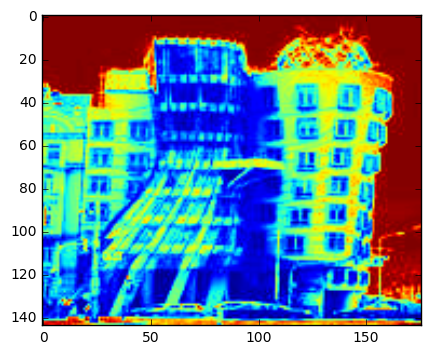

[  1.51023263e-02   1.34474623e-02   1.33494731e-02   1.90386914e-02
   1.55133479e-02   1.49659493e-02   8.81215246e-03   8.47740326e-03
   9.44333050e-03   1.12364442e-02   1.11478288e-02   1.03871211e-02
   6.69954895e-03   6.24357518e-03   7.55145729e-03   8.98898574e-03
   9.11913769e-03   7.95597857e-03   9.04786874e-03   6.36947748e-03
   5.60337850e-03   1.39904829e-02   6.35979075e-03   6.85601045e-03
   2.24047624e-03   1.66388006e-03   1.79224330e-03   2.71543423e-03
   1.93542982e-03   2.00910330e-03   1.10751758e-03   9.26589506e-04
   1.12006082e-03   1.52919859e-03   1.23470157e-03   1.13885496e-03
   2.09481480e+00   4.18962960e+00   6.28444430e+00   8.37901675e+00
   1.04740740e+00   5.23703699e-01   3.49135622e-01   2.61694480e-01
   3.49135622e-01   1.60859125e-01   5.10946856e-02   4.60276420e-03]


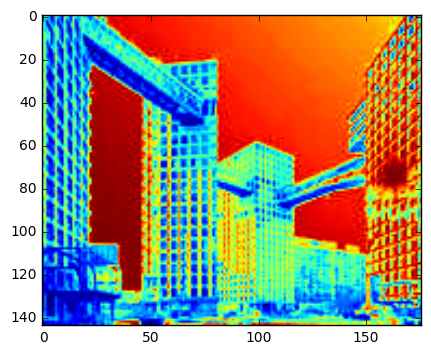

[  7.83412822e-03   6.13697439e-03   4.73318019e-03   4.43662903e-03
   4.73491278e-03   6.10091673e-03   4.67239920e-03   3.72484890e-03
   2.81295617e-03   2.41196922e-03   2.77122099e-03   3.98691260e-03
   3.36675433e-03   2.92405567e-03   1.91224813e-03   1.56273122e-03
   1.91524645e-03   3.13433239e-03   4.43972653e-03   2.56812881e-03
   2.20676526e-03   2.79608431e-03   2.12540728e-03   2.43199381e-03
   1.24652912e-03   8.01379033e-04   6.43872681e-04   7.73352922e-04
   6.19175508e-04   8.30275622e-04   5.76212654e-04   4.35075210e-04
   3.91668198e-04   3.73709922e-04   3.90825144e-04   4.77320456e-04
   1.75770612e+00   3.51541225e+00   5.27311830e+00   7.03062107e+00
   8.78853062e-01   4.39426531e-01   2.92950872e-01   2.19581220e-01
   2.92950872e-01   1.34972824e-01   4.28722586e-02   2.45527407e-03]


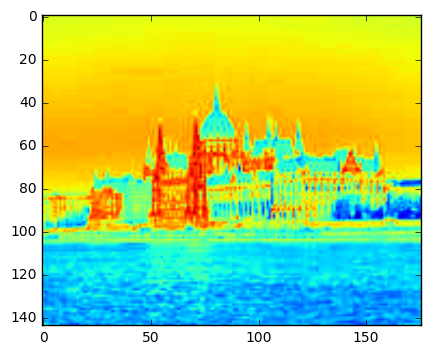

[  7.65315655e-03   6.89743656e-03   7.03079610e-03   7.07112207e-03
   7.04239338e-03   7.17777501e-03   5.92428189e-03   4.91053205e-03
   4.53570780e-03   4.92953889e-03   4.73638648e-03   5.02352987e-03
   4.71004924e-03   3.84185410e-03   3.49998055e-03   3.74295526e-03
   3.64154763e-03   3.98129622e-03   3.13111980e-03   2.01794311e-03
   2.53585811e-03   3.53312186e-03   2.69494525e-03   2.10527033e-03
   1.25101579e-03   7.42527373e-04   8.40160433e-04   1.33168155e-03
   1.02999435e-03   8.19004876e-04   7.24402136e-04   5.04266578e-04
   5.31793428e-04   7.16235265e-04   6.44105020e-04   5.58016531e-04
   2.01396912e+00   4.02793825e+00   6.04190729e+00   8.05564341e+00
   1.00698456e+00   5.03492281e-01   3.35661350e-01   2.51594844e-01
   3.35661350e-01   1.54651051e-01   4.91227766e-02   3.19778553e-03]


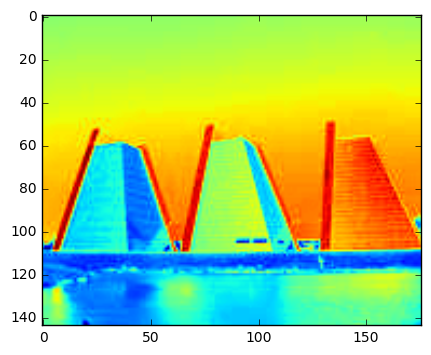

[  1.32130460e-02   1.09451516e-02   9.35959027e-03   1.07743742e-02
   9.90391841e-03   1.20743319e-02   7.26351825e-03   6.34433924e-03
   5.26295124e-03   6.07362013e-03   5.63837768e-03   6.47823802e-03
   4.95807917e-03   4.52305497e-03   3.98289359e-03   4.27164443e-03
   4.26668910e-03   4.40254796e-03   7.44807204e-03   5.21999342e-03
   3.99691386e-03   6.02061414e-03   4.16128648e-03   5.82215896e-03
   2.13656575e-03   1.52140775e-03   1.11075721e-03   1.77455526e-03
   1.15591319e-03   1.65756933e-03   1.01462250e-03   8.09949233e-04
   6.29355601e-04   7.73441606e-04   6.16030318e-04   7.51149643e-04
   1.97403672e+00   3.94807344e+00   5.92211007e+00   7.89591841e+00
   9.87018359e-01   4.93509179e-01   3.29005953e-01   2.46606293e-01
   3.29005953e-01   1.51584674e-01   4.81487841e-02   2.98559484e-03]


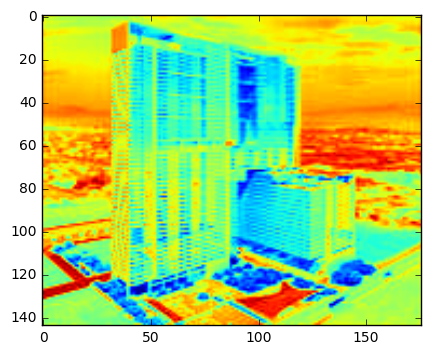

[  1.10500559e-02   7.64435573e-03   8.63973648e-03   1.14255558e-02
   9.59526602e-03   8.31391026e-03   4.53772942e-03   4.23540331e-03
   5.04397289e-03   7.20231339e-03   6.09795787e-03   4.98823154e-03
   3.26231901e-03   2.94878715e-03   3.63954760e-03   5.26909152e-03
   4.43647029e-03   3.63599848e-03   9.81567699e-03   3.62626577e-03
   3.68612325e-03   7.07959848e-03   3.96637857e-03   4.05590332e-03
   1.27633548e-03   9.42603749e-04   1.10198925e-03   2.28611609e-03
   1.35019091e-03   1.08572905e-03   6.13842097e-04   5.32888317e-04
   6.23795976e-04   1.13647371e-03   7.59062278e-04   6.26993092e-04
   1.95914255e+00   3.91828510e+00   5.87742757e+00   7.83634347e+00
   9.79571276e-01   4.89785638e-01   3.26523593e-01   2.44745641e-01
   3.26523593e-01   1.50440963e-01   4.77855001e-02   2.83323443e-03]


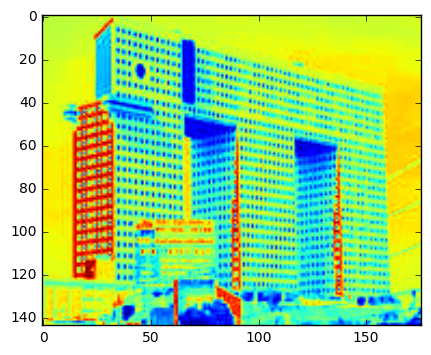

[  1.05921099e-02   1.01545556e-02   1.08897459e-02   1.28860580e-02
   1.14147068e-02   1.03698845e-02   7.48910981e-03   7.06267579e-03
   6.89075037e-03   7.50800301e-03   7.22402833e-03   6.81911677e-03
   6.24243389e-03   6.02834126e-03   4.98888877e-03   5.28058881e-03
   5.20029416e-03   5.73089605e-03   5.29732787e-03   4.00787597e-03
   4.73984489e-03   7.48144173e-03   4.97924771e-03   4.55158051e-03
   1.53576400e-03   1.33710148e-03   1.52831758e-03   2.16199257e-03
   1.65647615e-03   1.38608527e-03   7.49814157e-04   7.68356921e-04
   8.73205987e-04   1.02136470e-03   9.53703606e-04   7.67739867e-04
   1.74282889e+00   3.48565778e+00   5.22848660e+00   6.97111387e+00
   8.71414446e-01   4.35707223e-01   2.90471335e-01   2.17722684e-01
   2.90471335e-01   1.33830413e-01   4.25101970e-02   2.83425558e-03]


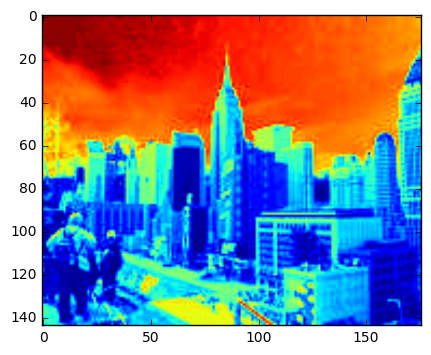

[  2.00860110e-02   1.61256837e-02   1.54534132e-02   1.70020343e-02
   1.68166769e-02   1.84022224e-02   1.08481448e-02   9.56776100e-03
   8.55570087e-03   8.94952230e-03   9.59765653e-03   1.00809839e-02
   7.91050501e-03   7.29478037e-03   5.67614789e-03   5.80608220e-03
   6.70503205e-03   7.29788389e-03   1.20522316e-02   7.71940106e-03
   7.56952930e-03   1.02202941e-02   8.38787817e-03   9.56258685e-03
   2.86945373e-03   2.17427796e-03   2.15946540e-03   2.62800994e-03
   2.49481326e-03   2.39542492e-03   1.32265674e-03   1.11561483e-03
   1.00539302e-03   1.22887105e-03   1.24008757e-03   1.07898187e-03
   1.46611395e+00   2.93222790e+00   4.39834179e+00   5.86428613e+00
   7.33056976e-01   3.66528488e-01   2.44352201e-01   1.83154104e-01
   2.44352201e-01   1.12581698e-01   3.57600259e-02   3.15606724e-03]


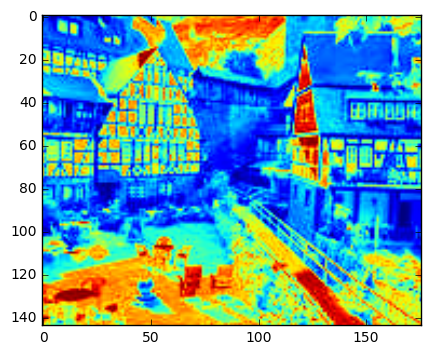

[  1.25838883e-02   1.13908699e-02   9.94193831e-03   1.00820988e-02
   9.48414205e-03   1.07215345e-02   7.94338320e-03   7.36399020e-03
   6.38019700e-03   6.04124822e-03   6.11300271e-03   6.61805091e-03
   5.84766512e-03   5.66443144e-03   4.73763778e-03   4.42234057e-03
   4.72134355e-03   5.12379531e-03   7.04773188e-03   4.94315737e-03
   4.24084213e-03   6.02475090e-03   3.97882190e-03   4.85110232e-03
   2.17654212e-03   1.59146699e-03   1.34960359e-03   1.67842611e-03
   1.32245606e-03   1.44548671e-03   1.09577634e-03   8.65597618e-04
   7.59265942e-04   7.89274412e-04   7.25881572e-04   7.70187749e-04
   2.08436737e+00   4.16873475e+00   6.25310203e+00   8.33722826e+00
   1.04218369e+00   5.21091843e-01   3.47394386e-01   2.60389337e-01
   3.47394386e-01   1.60056876e-01   5.08398622e-02   3.13320695e-03]


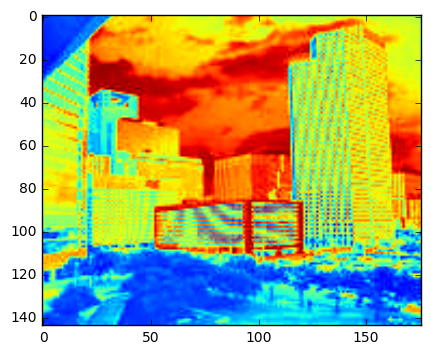

[  1.06058261e-02   8.67096271e-03   8.64907126e-03   1.09691307e-02
   9.09328578e-03   9.03163671e-03   5.92860279e-03   5.19986746e-03
   5.29809657e-03   6.37275474e-03   5.99686043e-03   5.85149035e-03
   4.33557394e-03   3.80071658e-03   3.74470687e-03   4.63773504e-03
   4.56549928e-03   4.43532102e-03   7.26465177e-03   3.39412023e-03
   3.60644234e-03   7.81292704e-03   3.49157051e-03   3.56672675e-03
   1.89380018e-03   1.08468222e-03   1.14915336e-03   2.02935957e-03
   1.13279958e-03   1.17695754e-03   8.81097130e-04   6.30127700e-04
   6.61983481e-04   1.01928604e-03   6.90995099e-04   6.75149190e-04
   1.74707183e+00   3.49414367e+00   5.24121542e+00   6.98808514e+00
   8.73535917e-01   4.36767958e-01   2.91178491e-01   2.18252733e-01
   2.91178491e-01   1.34156225e-01   4.26128774e-02   2.78301805e-03]


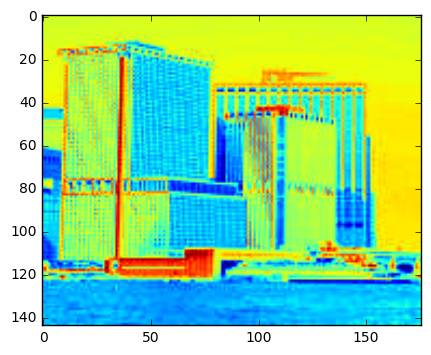

[  1.26247403e-02   9.69183173e-03   9.06583500e-03   1.05792939e-02
   1.01171950e-02   1.12789604e-02   7.37895552e-03   5.76453187e-03
   5.29226348e-03   5.52273467e-03   5.80760835e-03   6.57332982e-03
   5.28404812e-03   4.57498179e-03   4.20972657e-03   4.00577207e-03
   4.56354443e-03   5.05025175e-03   6.71146127e-03   4.35094839e-03
   4.33847404e-03   7.10891725e-03   5.05000788e-03   5.07026921e-03
   2.00525246e-03   1.18659445e-03   1.18224980e-03   1.69068149e-03
   1.31930559e-03   1.41287970e-03   8.54579746e-04   5.71173455e-04
   5.50408438e-04   6.77242450e-04   6.59513335e-04   6.58783273e-04
   1.39981303e+00   2.79962606e+00   4.19943904e+00   5.59909012e+00
   6.99906516e-01   3.49953258e-01   2.33302054e-01   1.74871470e-01
   2.33302054e-01   1.07490504e-01   3.41428784e-02   2.40234227e-03]


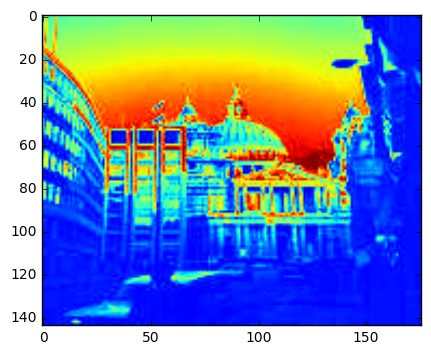

[  1.15540372e-02   1.02230088e-02   9.05900388e-03   9.58261091e-03
   9.32758943e-03   1.02236462e-02   8.61526992e-03   7.21715047e-03
   5.59865921e-03   5.90381990e-03   5.74112206e-03   7.39667524e-03
   7.13809048e-03   6.04113540e-03   4.04855057e-03   4.07181199e-03
   4.22681405e-03   6.17535175e-03   5.54016312e-03   4.18869319e-03
   3.97113746e-03   5.02241667e-03   3.89181907e-03   4.13608805e-03
   1.89920675e-03   1.37102038e-03   1.21978279e-03   1.66613844e-03
   1.22368497e-03   1.42624472e-03   1.09156859e-03   8.05570130e-04
   6.61036044e-04   7.76664870e-04   6.80278808e-04   8.38954204e-04
   1.77691249e+00   3.55382498e+00   5.33073740e+00   7.10744432e+00
   8.88457057e-01   4.44228123e-01   2.96151932e-01   2.21980574e-01
   2.96151932e-01   1.36447665e-01   4.33407217e-02   3.04937659e-03]


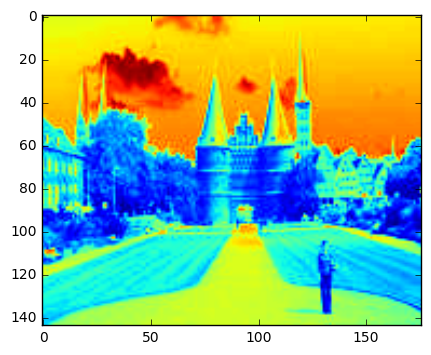

[  1.28005517e-02   1.27514879e-02   1.51915740e-02   2.04359329e-02
   1.53372186e-02   1.28694410e-02   6.00077425e-03   5.79013726e-03
   6.75076448e-03   9.62647803e-03   7.12627853e-03   5.93591471e-03
   4.09497235e-03   3.84846336e-03   4.20083651e-03   5.93391279e-03
   4.76568033e-03   4.09290704e-03   7.87793886e-03   7.51272919e-03
   8.78291938e-03   1.35033009e-02   8.40220442e-03   7.65397926e-03
   1.82814059e-03   1.62823079e-03   1.86490302e-03   3.35431539e-03
   1.88263624e-03   1.62676534e-03   7.34357415e-04   6.66461539e-04
   7.70655756e-04   1.36797610e-03   8.27739858e-04   6.71941962e-04
   1.37217577e+00   2.74435154e+00   4.11652725e+00   5.48854428e+00
   6.86087885e-01   3.43043943e-01   2.28695846e-01   1.71418889e-01
   2.28695846e-01   1.05368262e-01   3.34687772e-02   2.43241488e-03]


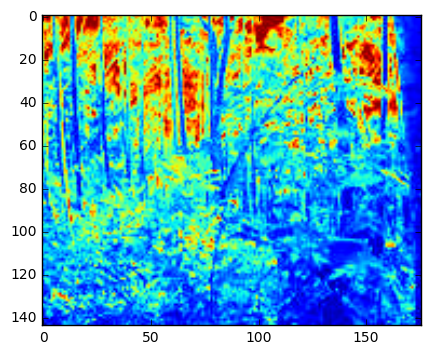

[  6.90231991e-03   7.22362496e-03   9.52450011e-03   1.28936076e-02
   9.99607340e-03   7.73881694e-03   4.47637334e-03   4.37326174e-03
   4.92132454e-03   6.53897037e-03   5.30666421e-03   4.33641662e-03
   3.68595064e-03   3.59022171e-03   3.40803961e-03   4.47160569e-03
   3.55243016e-03   3.38068454e-03   3.37458667e-03   3.34438682e-03
   5.02504623e-03   8.14824475e-03   5.13599731e-03   3.88976338e-03
   8.82833626e-04   8.28553876e-04   1.15087910e-03   2.00151253e-03
   1.28087780e-03   8.86904959e-04   4.04730775e-04   4.19470725e-04
   5.62883781e-04   8.98504187e-04   6.01971050e-04   3.98407200e-04
   1.68262140e+00   3.36524279e+00   5.04786412e+00   6.73029085e+00
   8.41310699e-01   4.20655349e-01   2.80436757e-01   2.10201270e-01
   2.80436757e-01   1.29207129e-01   4.10408650e-02   2.41964265e-03]


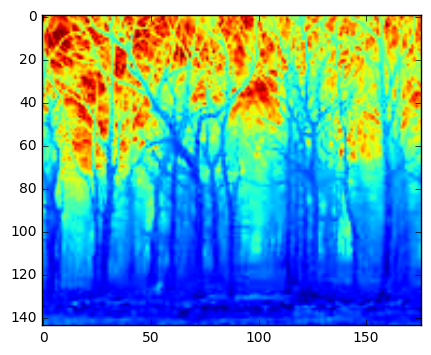

[  1.10134753e-02   1.03675108e-02   1.23685533e-02   1.54481974e-02
   1.19914131e-02   1.10966604e-02   6.60134642e-03   5.72096668e-03
   6.09485686e-03   7.32004608e-03   5.99487314e-03   6.49403634e-03
   5.08087842e-03   4.18604934e-03   3.91435485e-03   4.48302874e-03
   4.07851213e-03   4.77663602e-03   5.67051086e-03   5.02667265e-03
   6.46737160e-03   9.94872349e-03   6.12648477e-03   5.29906861e-03
   1.53328837e-03   1.23832076e-03   1.60008969e-03   2.45125702e-03
   1.46267628e-03   1.42394728e-03   7.53375272e-04   6.16326704e-04
   6.98772240e-04   1.00650654e-03   6.66697847e-04   6.86890251e-04
   1.19358876e+00   2.38717752e+00   3.58076623e+00   4.77421690e+00
   5.96794380e-01   2.98397190e-01   1.98931359e-01   1.49108928e-01
   1.98931359e-01   9.16547102e-02   2.91128564e-02   2.19489023e-03]


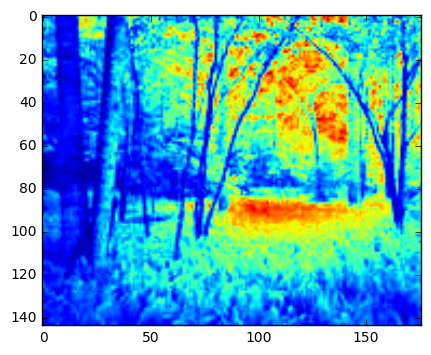

[  1.40773566e-02   1.45853050e-02   1.91694132e-02   2.52685058e-02
   1.79067984e-02   1.41965095e-02   7.34423413e-03   7.91838055e-03
   9.92059463e-03   1.21595445e-02   8.65020821e-03   7.51187847e-03
   5.45425329e-03   5.91349128e-03   6.73810901e-03   7.82543849e-03
   6.01766278e-03   5.38610706e-03   8.11459495e-03   7.28236104e-03
   9.90587024e-03   1.55473400e-02   9.09674616e-03   7.57725291e-03
   1.99515381e-03   1.81619979e-03   2.51583001e-03   4.13034587e-03
   2.14395795e-03   1.85737527e-03   8.80658477e-04   8.61977745e-04
   1.19374552e-03   1.69158045e-03   1.01403604e-03   8.60086218e-04
   1.28081654e+00   2.56163308e+00   3.84244957e+00   5.12311793e+00
   6.40408271e-01   3.20204135e-01   2.13469315e-01   1.60005848e-01
   2.13469315e-01   9.83528606e-02   3.12404317e-02   2.93732146e-03]


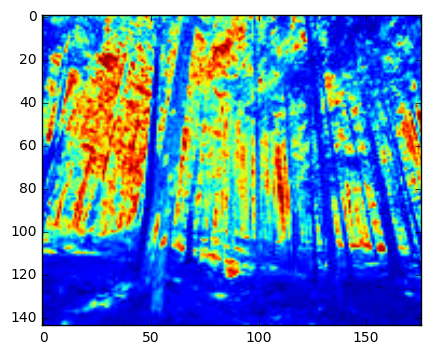

[  1.41724082e-02   1.49213477e-02   1.81792927e-02   2.12231231e-02
   1.74396130e-02   1.46129392e-02   6.99674056e-03   7.76753161e-03
   9.45306785e-03   1.17580756e-02   8.95261114e-03   7.02207672e-03
   4.43887372e-03   4.87345690e-03   6.25583790e-03   7.49974578e-03
   5.82212262e-03   4.45961623e-03   7.50364507e-03   7.33214728e-03
   8.68657758e-03   1.15018586e-02   8.58196353e-03   7.51168230e-03
   2.04133961e-03   2.04057659e-03   2.48186252e-03   3.76806216e-03
   2.47269280e-03   2.00029225e-03   9.01286759e-04   9.29275720e-04
   1.19079753e-03   1.69136642e-03   1.15118899e-03   8.84163485e-04
   1.48719767e+00   2.97439534e+00   4.46159294e+00   5.94861856e+00
   7.43598835e-01   3.71799417e-01   2.47866152e-01   1.85787985e-01
   2.47866152e-01   1.14200700e-01   3.62742795e-02   2.64365478e-03]


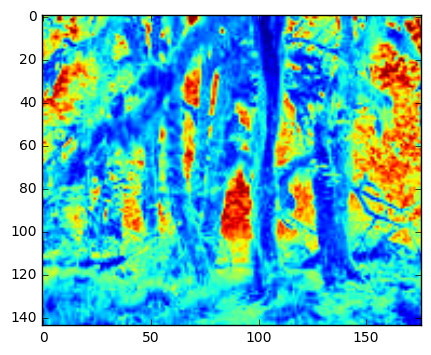

[  1.18328470e-02   1.18814907e-02   1.14988746e-02   1.16561720e-02
   1.15754955e-02   1.14953608e-02   6.43075598e-03   6.87930415e-03
   6.56675109e-03   6.56961481e-03   6.87501067e-03   6.36043470e-03
   4.46253013e-03   4.82441107e-03   4.66136592e-03   4.67425840e-03
   5.12473745e-03   4.59933184e-03   6.18211482e-03   5.86884683e-03
   5.84831338e-03   6.12926879e-03   5.65122462e-03   6.02677276e-03
   1.64466171e-03   1.71916205e-03   1.63890055e-03   1.60560265e-03
   1.67528639e-03   1.57015278e-03   7.93401238e-04   8.65605211e-04
   8.26888945e-04   7.87997995e-04   8.45861681e-04   7.61680451e-04
   1.26894449e+00   2.53788898e+00   3.80683342e+00   5.07563110e+00
   6.34472245e-01   3.17236123e-01   2.11490641e-01   1.58522734e-01
   2.11490641e-01   9.74412155e-02   3.09508601e-02   2.40452392e-03]


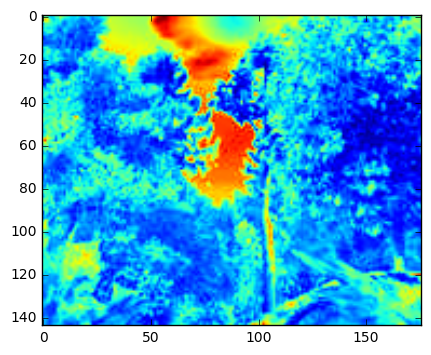

[  1.41093455e-02   1.19972181e-02   1.00330933e-02   1.00154318e-02
   1.01690885e-02   1.25135960e-02   6.86769622e-03   5.71520095e-03
   4.66239831e-03   4.79197408e-03   4.75861167e-03   5.69607379e-03
   4.35923289e-03   3.73265795e-03   3.04336003e-03   3.18965820e-03
   3.06002017e-03   3.56605265e-03   8.68607773e-03   6.83639521e-03
   5.62482798e-03   6.16376094e-03   5.73892391e-03   7.29193843e-03
   2.12348218e-03   1.64974841e-03   1.32618914e-03   1.42226408e-03
   1.32310764e-03   1.67843315e-03   9.00297092e-04   7.27210038e-04
   5.80172658e-04   5.93829381e-04   5.71287028e-04   6.93945035e-04
   1.37838874e+00   2.75677748e+00   4.13516616e+00   5.51339543e+00
   6.89194369e-01   3.44597185e-01   2.29731340e-01   1.72195043e-01
   2.29731340e-01   1.05845350e-01   3.36203178e-02   2.08415180e-03]


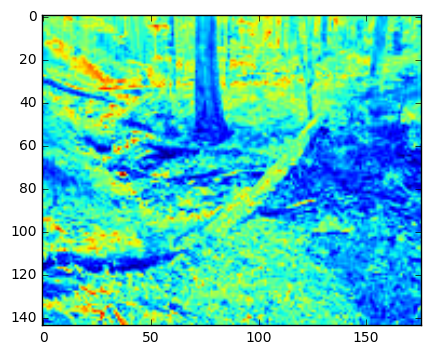

[  1.64384849e-02   1.49941413e-02   1.99397330e-02   2.83471467e-02
   1.96918891e-02   1.55037956e-02   7.09529228e-03   5.98640696e-03
   8.37562395e-03   1.44665218e-02   8.27401178e-03   6.92133559e-03
   4.01044525e-03   3.49214529e-03   4.87713421e-03   8.53655449e-03
   4.70205930e-03   4.03754135e-03   1.02951618e-02   8.45621262e-03
   1.04461150e-02   1.69598482e-02   9.91461919e-03   8.50659090e-03
   2.51853819e-03   1.81734246e-03   2.30428625e-03   5.35311443e-03
   2.25547025e-03   2.04294748e-03   9.67851948e-04   7.43213462e-04
   8.69425219e-04   2.22143719e-03   8.93084476e-04   8.88239168e-04
   1.17006778e+00   2.34013557e+00   3.51020330e+00   4.68013572e+00
   5.85033891e-01   2.92516946e-01   1.95011198e-01   1.46170573e-01
   1.95011198e-01   8.98485535e-02   2.85391556e-02   2.20990134e-03]


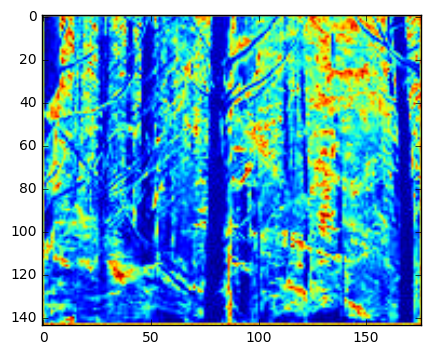

[  1.11541422e-02   1.19407922e-02   1.77130872e-02   2.62468969e-02
   1.75394434e-02   1.18695834e-02   4.98381707e-03   5.09913914e-03
   8.57742809e-03   1.45007760e-02   8.17485883e-03   4.98458885e-03
   3.10040668e-03   3.11285991e-03   5.59376730e-03   9.09170697e-03
   5.00732763e-03   3.05989266e-03   7.30546009e-03   6.21310067e-03
   8.30524114e-03   1.69614149e-02   7.85120640e-03   6.30132066e-03
   1.61072440e-03   1.31754110e-03   2.04535171e-03   4.96500632e-03
   1.97802618e-03   1.25721348e-03   6.67331814e-04   5.25162648e-04
   9.13266221e-04   2.28646837e-03   7.82505148e-04   5.43933760e-04
   1.68106376e+00   3.36212752e+00   5.04319120e+00   6.72406048e+00
   8.40531879e-01   4.20265939e-01   2.80177151e-01   2.10006682e-01
   2.80177151e-01   1.29087519e-01   4.10028726e-02   2.87662446e-03]


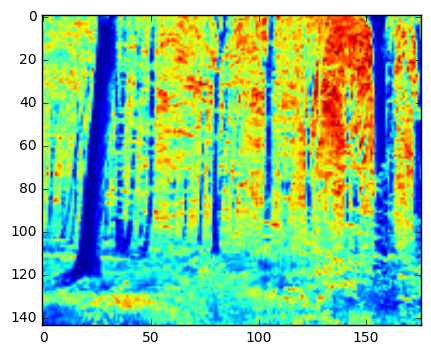

[  1.15778562e-02   1.09405784e-02   1.07872238e-02   1.31338265e-02
   1.19422207e-02   1.21156649e-02   6.29802801e-03   6.47130192e-03
   6.78715062e-03   7.79517847e-03   6.96287265e-03   6.84409760e-03
   4.43868761e-03   4.87051445e-03   5.64839434e-03   5.98620103e-03
   5.45408943e-03   4.62265130e-03   6.06525720e-03   5.36393278e-03
   5.00622339e-03   7.22452786e-03   5.33158649e-03   6.08567528e-03
   1.56510785e-03   1.36160647e-03   1.26292828e-03   2.02095739e-03
   1.42034879e-03   1.76792634e-03   7.30701242e-04   6.71186612e-04
   6.81002568e-04   9.24298372e-04   7.43176099e-04   8.18085762e-04
   1.42517148e+00   2.85034295e+00   4.27551436e+00   5.70052096e+00
   7.12585738e-01   3.56292869e-01   2.37528459e-01   1.78039370e-01
   2.37528459e-01   1.09437759e-01   3.47613968e-02   2.63661198e-03]


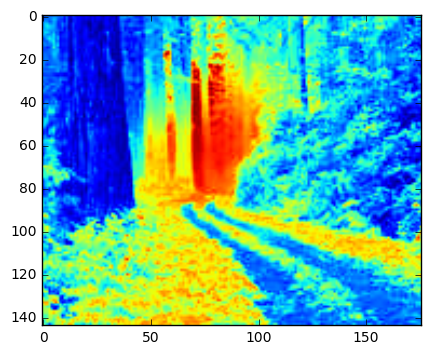

[  9.99549302e-03   9.55016995e-03   1.21871715e-02   1.83112732e-02
   1.18563723e-02   9.09656887e-03   5.16277170e-03   4.54243122e-03
   4.80192967e-03   7.92282373e-03   4.82266822e-03   4.34261933e-03
   3.51586206e-03   3.02207795e-03   2.98063626e-03   4.20649713e-03
   2.94614572e-03   3.03531317e-03   6.13519170e-03   5.51039919e-03
   6.70836976e-03   1.27695582e-02   6.50166683e-03   5.31046841e-03
   1.49587398e-03   1.19613264e-03   1.37272711e-03   3.11702786e-03
   1.44411158e-03   1.10859251e-03   6.51971869e-04   5.14484197e-04
   5.13182188e-04   1.14574325e-03   5.43212989e-04   4.98676468e-04
   1.35037446e+00   2.70074893e+00   4.05112333e+00   5.40134157e+00
   6.75187231e-01   3.37593616e-01   2.25062296e-01   1.68695363e-01
   2.25062296e-01   1.03694157e-01   3.29370209e-02   2.08855443e-03]


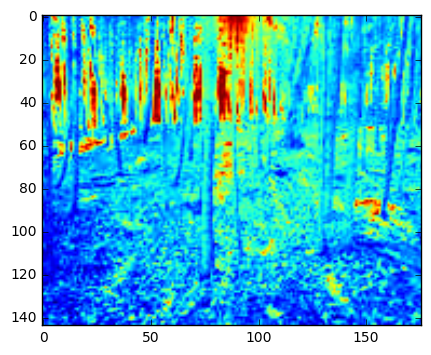

[  1.72693163e-02   1.49731468e-02   1.49455122e-02   1.82798861e-02
   1.67405565e-02   1.66372108e-02   8.66609989e-03   6.96568658e-03
   7.89229219e-03   1.04065750e-02   9.39134241e-03   8.82941339e-03
   5.69061935e-03   4.39401581e-03   5.48105096e-03   7.21087606e-03
   6.57996098e-03   6.00740015e-03   1.04199555e-02   8.32818877e-03
   7.53950405e-03   1.09538153e-02   7.96161735e-03   8.71249159e-03
   2.54672612e-03   1.92594396e-03   1.93899429e-03   2.96184533e-03
   2.08389367e-03   2.21799393e-03   1.10147474e-03   7.73100578e-04
   9.23291938e-04   1.42300177e-03   1.03221355e-03   1.04182473e-03
   1.41348180e+00   2.82696360e+00   4.24044534e+00   5.65376361e+00
   7.06740900e-01   3.53370450e-01   2.35580180e-01   1.76579039e-01
   2.35580180e-01   1.08540118e-01   3.44762737e-02   3.09342284e-03]


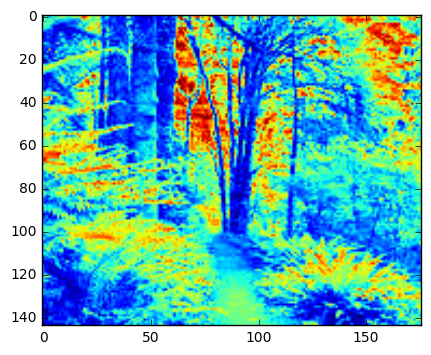

[  1.55874345e-02   1.51968571e-02   1.51587234e-02   1.57910418e-02
   1.37769301e-02   1.38005692e-02   7.37345084e-03   6.99922104e-03
   8.04926175e-03   9.63900956e-03   7.35568928e-03   6.39295122e-03
   4.37750914e-03   4.42923799e-03   5.62532980e-03   6.90818806e-03
   5.16984586e-03   4.12984700e-03   9.23189317e-03   8.47125867e-03
   7.65076140e-03   8.43025467e-03   6.87131738e-03   7.60285991e-03
   2.45614618e-03   1.98948749e-03   2.00307759e-03   2.56431952e-03
   1.76710009e-03   1.78566908e-03   9.88748034e-04   8.43387295e-04
   9.13849223e-04   1.28266652e-03   8.13319413e-04   8.10757789e-04
   1.52330154e+00   3.04660308e+00   4.56990455e+00   6.09302986e+00
   7.61650769e-01   3.80825385e-01   2.53883461e-01   1.90298256e-01
   2.53883461e-01   1.16973086e-01   3.71548899e-02   2.64178968e-03]


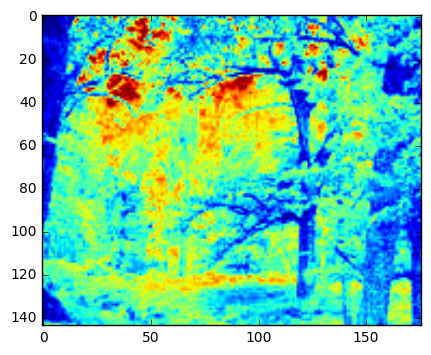

[  5.74731195e-03   8.24762473e-03   1.67499561e-02   3.29415707e-02
   1.65095532e-02   8.02159506e-03   2.74580044e-03   3.52773327e-03
   6.72706614e-03   1.14762147e-02   6.73309802e-03   3.45897930e-03
   1.81695382e-03   2.17445965e-03   4.04164849e-03   6.04553679e-03
   3.92401802e-03   2.15617716e-03   2.92242095e-03   3.66008404e-03
   8.77226842e-03   2.65198652e-02   8.54378413e-03   3.62133859e-03
   7.90680091e-04   8.49807294e-04   1.97086543e-03   4.65842084e-03
   1.98215280e-03   8.43721028e-04   3.39329631e-04   3.74972181e-04
   8.39353403e-04   1.57282577e-03   8.60320136e-04   3.76938424e-04
   1.40703671e+00   2.81407342e+00   4.22111008e+00   5.62798401e+00
   7.03518356e-01   3.51759178e-01   2.34506000e-01   1.75773887e-01
   2.34506000e-01   1.08045205e-01   3.43190713e-02   2.07881981e-03]


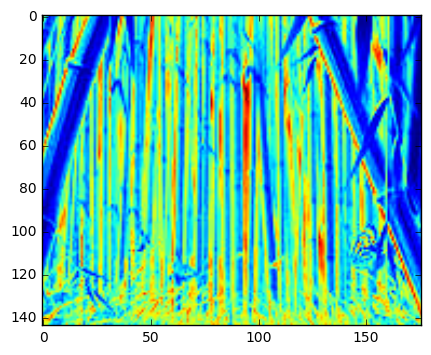

[  1.27782901e-02   1.38750476e-02   1.61758643e-02   1.75562898e-02
   1.34862371e-02   1.22263750e-02   8.43612858e-03   8.27998310e-03
   9.46791739e-03   1.04286748e-02   7.35291661e-03   7.55081874e-03
   6.68920211e-03   5.88401926e-03   6.39719208e-03   7.08772679e-03
   4.90591534e-03   5.76769154e-03   6.17979270e-03   5.77022105e-03
   7.04041152e-03   9.06723882e-03   5.70002822e-03   5.29061445e-03
   1.76909251e-03   1.59435436e-03   2.23175316e-03   2.89508606e-03
   1.52245433e-03   1.46384744e-03   1.02582186e-03   8.03249413e-04
   1.13896274e-03   1.44096419e-03   7.04788397e-04   8.04485334e-04
   1.40321887e+00   2.80643775e+00   4.20965656e+00   5.61271310e+00
   7.01609437e-01   3.50804718e-01   2.33869694e-01   1.75296944e-01
   2.33869694e-01   1.07752036e-01   3.42259503e-02   3.36928267e-03]


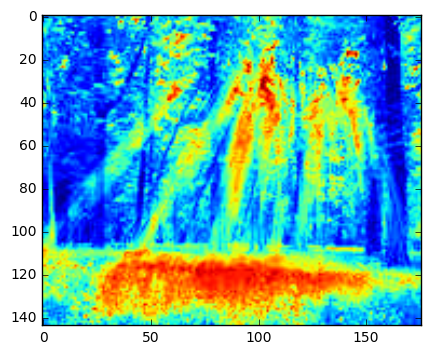

[  8.59500303e-03   9.13831058e-03   1.10350929e-02   1.31647175e-02
   1.10902223e-02   8.88930967e-03   5.08414161e-03   5.31628229e-03
   6.08389166e-03   8.14891420e-03   6.52055771e-03   5.03312096e-03
   3.82876147e-03   4.06826561e-03   4.25540874e-03   5.72602527e-03
   4.75365300e-03   3.69769495e-03   4.36799364e-03   4.46335633e-03
   5.07924306e-03   6.75747913e-03   5.04407556e-03   4.03431476e-03
   1.13039181e-03   1.14089034e-03   1.35281156e-03   2.29138149e-03
   1.46926321e-03   1.01964739e-03   5.42154314e-04   5.97994588e-04
   6.27046400e-04   1.12796192e-03   7.50922932e-04   4.74065066e-04
   1.24790022e+00   2.49580043e+00   3.74370059e+00   4.99145644e+00
   6.23950108e-01   3.11975054e-01   2.07983264e-01   1.55893780e-01
   2.07983264e-01   9.58252427e-02   3.04375686e-02   2.20910794e-03]


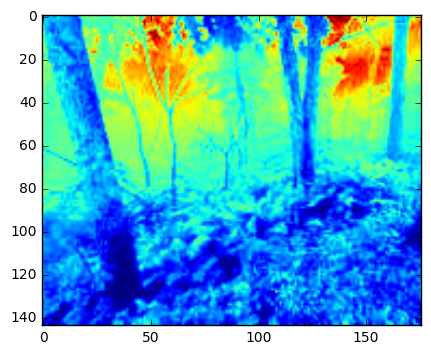

[  8.39979187e-03   7.63919481e-03   7.19641178e-03   8.09363257e-03
   7.47660073e-03   7.76910005e-03   5.03084957e-03   4.37587827e-03
   4.04791423e-03   4.20960248e-03   4.06283100e-03   4.65450921e-03
   3.95167071e-03   3.47451847e-03   2.84204198e-03   2.92427109e-03
   2.93114380e-03   3.74435365e-03   4.38972922e-03   3.94370798e-03
   3.75827278e-03   4.68345550e-03   3.75567291e-03   3.84928653e-03
   1.00466684e-03   8.86993293e-04   9.84514854e-04   1.18058926e-03
   9.43438821e-04   8.95090689e-04   4.44869189e-04   4.18056240e-04
   4.99852493e-04   5.29813527e-04   4.47649533e-04   4.32153777e-04
   1.58831399e+00   3.17662798e+00   4.76494191e+00   6.35307215e+00
   7.94156996e-01   3.97078498e-01   2.64718864e-01   1.98419929e-01
   2.64718864e-01   1.21965340e-01   3.87406105e-02   2.29909535e-03]


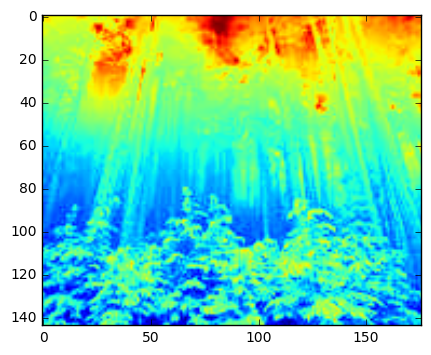

[  5.43935240e-03   6.04915734e-03   8.42343828e-03   1.47613242e-02
   1.02851481e-02   6.74004924e-03   3.07862438e-03   3.43199210e-03
   4.20850442e-03   7.41630640e-03   5.00817388e-03   3.30491612e-03
   2.18286412e-03   2.52478615e-03   2.80971800e-03   4.63331090e-03
   3.12632181e-03   2.17158202e-03   2.82202014e-03   2.95646662e-03
   3.62808120e-03   9.51148539e-03   4.92467880e-03   3.14151509e-03
   7.53409311e-04   7.90711355e-04   8.70989663e-04   2.57052868e-03
   1.16659154e-03   8.23314387e-04   3.74424676e-04   4.08246339e-04
   4.11985210e-04   1.02002861e-03   5.73638985e-04   3.92915008e-04
   1.19839680e+00   2.39679359e+00   3.59519034e+00   4.79344850e+00
   5.99198399e-01   2.99599199e-01   1.99732698e-01   1.49709572e-01
   1.99732698e-01   9.20239155e-02   2.92301294e-02   1.79750386e-03]


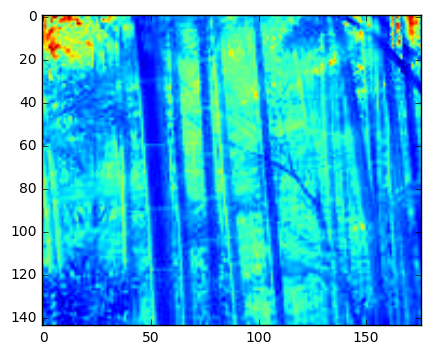

[  9.86798001e-03   8.17369179e-03   5.69531764e-03   4.71644766e-03
   6.02269168e-03   8.61833450e-03   6.81462033e-03   5.34839167e-03
   3.32494477e-03   2.13712341e-03   3.27796610e-03   5.75442381e-03
   5.43129340e-03   4.26745732e-03   2.37792064e-03   1.52580287e-03
   2.16447666e-03   4.52406321e-03   4.77839846e-03   3.53752611e-03
   2.89291182e-03   3.28383670e-03   2.97877943e-03   3.81742072e-03
   1.58765211e-03   9.44661057e-04   6.09713664e-04   5.73641116e-04
   6.70404759e-04   1.14271452e-03   8.94815773e-04   5.44393747e-04
   3.46260946e-04   2.38529093e-04   3.71345620e-04   6.79067575e-04
   1.93311339e+00   3.86622679e+00   5.79934010e+00   7.73222985e+00
   9.66556697e-01   4.83278348e-01   3.22185402e-01   2.41493952e-01
   3.22185402e-01   1.48442205e-01   4.71506222e-02   2.92781132e-03]


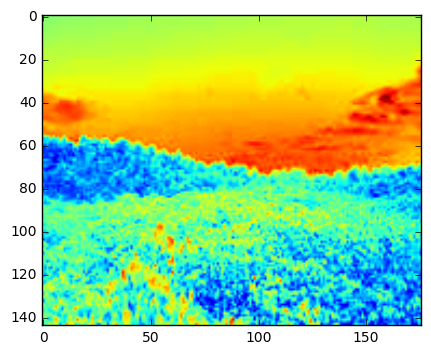

[  1.11003210e-02   1.11387111e-02   1.35478244e-02   2.02857880e-02
   1.31418510e-02   1.04103512e-02   5.39763574e-03   5.23997871e-03
   5.88454897e-03   9.52650142e-03   5.96026513e-03   5.00125788e-03
   3.65356612e-03   3.51753383e-03   3.84390253e-03   5.67255781e-03
   3.85533839e-03   3.44050967e-03   7.28744798e-03   6.47453725e-03
   7.30623279e-03   1.43138442e-02   6.78287814e-03   5.89791225e-03
   1.52803649e-03   1.44500044e-03   1.56454073e-03   3.48089361e-03
   1.50703072e-03   1.26692350e-03   6.58756918e-04   6.20766268e-04
   6.47507898e-04   1.42007440e-03   6.24155639e-04   5.84667798e-04
   1.39973696e+00   2.79947392e+00   4.19921082e+00   5.59878584e+00
   6.99868480e-01   3.49934240e-01   2.33289375e-01   1.74861967e-01
   2.33289375e-01   1.07484663e-01   3.41410229e-02   2.24797242e-03]


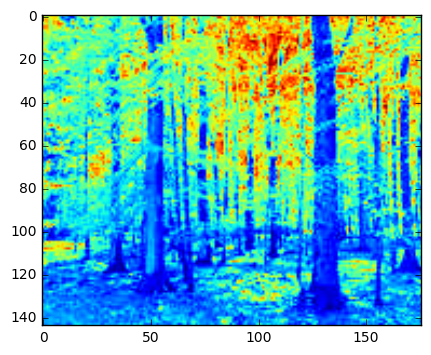

[  1.33536738e-02   1.24077649e-02   1.21589713e-02   1.21383977e-02
   1.14095347e-02   1.26008695e-02   7.01052916e-03   6.70503737e-03
   6.81992744e-03   6.85098412e-03   5.96454852e-03   6.41603053e-03
   4.62062937e-03   4.62105909e-03   4.76590313e-03   4.61592105e-03
   3.93171718e-03   4.13076229e-03   7.70117152e-03   6.42758186e-03
   6.04913044e-03   6.47711707e-03   5.57599145e-03   6.49140635e-03
   2.07400200e-03   1.74853701e-03   1.60571389e-03   1.89339192e-03
   1.48843131e-03   1.69276429e-03   9.75216847e-04   8.27751542e-04
   7.86960547e-04   8.99333873e-04   6.96442658e-04   7.22005072e-04
   1.00697774e+00   2.01395548e+00   3.02093318e+00   4.02779443e+00
   5.03488871e-01   2.51744436e-01   1.67829539e-01   1.25796570e-01
   1.67829539e-01   7.73250019e-02   2.45612219e-02   2.10661086e-03]


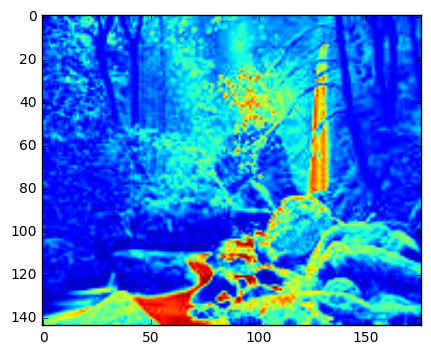

[  1.41648869e-02   1.41298206e-02   1.56079218e-02   1.51776084e-02
   1.23325545e-02   1.24740151e-02   7.52506076e-03   8.09441919e-03
   8.84800131e-03   8.03412014e-03   6.46533501e-03   6.38309570e-03
   5.22995623e-03   6.02172574e-03   5.99444664e-03   5.32919245e-03
   4.42684949e-03   4.52752611e-03   7.90445521e-03   7.02209984e-03
   7.46622620e-03   7.92516188e-03   6.31410944e-03   6.70814765e-03
   1.99839917e-03   1.87713977e-03   2.36978149e-03   2.25157922e-03
   1.65624410e-03   1.58921198e-03   8.85242057e-04   9.30948725e-04
   1.11409840e-03   1.02842403e-03   7.65595687e-04   6.99404592e-04
   1.00122180e+00   2.00244360e+00   3.00366536e+00   4.00477133e+00
   5.00610901e-01   2.50305450e-01   1.66870216e-01   1.25077510e-01
   1.66870216e-01   7.68830079e-02   2.44208286e-02   2.30003822e-03]


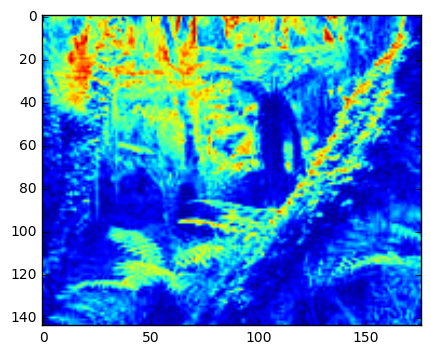

[  9.84569414e-03   1.02901326e-02   1.27378619e-02   1.56653429e-02
   1.34802659e-02   1.08259009e-02   5.27950474e-03   5.67986216e-03
   8.03538741e-03   1.06302269e-02   8.69538529e-03   6.08136192e-03
   3.47467273e-03   3.78738900e-03   6.22197295e-03   8.06115651e-03
   6.51387557e-03   4.04326395e-03   5.31502656e-03   4.87477505e-03
   5.52457202e-03   8.40048174e-03   5.97121756e-03   4.86447760e-03
   1.52919551e-03   1.32813868e-03   1.62342080e-03   2.95621594e-03
   1.85813688e-03   1.38227961e-03   6.78806658e-04   6.21365387e-04
   8.88848550e-04   1.54429069e-03   1.00276358e-03   6.35378846e-04
   9.32287493e-01   1.86457499e+00   2.79686244e+00   3.72904208e+00
   4.66143747e-01   2.33071873e-01   1.55381170e-01   1.16465900e-01
   1.55381170e-01   7.15895984e-02   2.27394500e-02   2.70630623e-03]


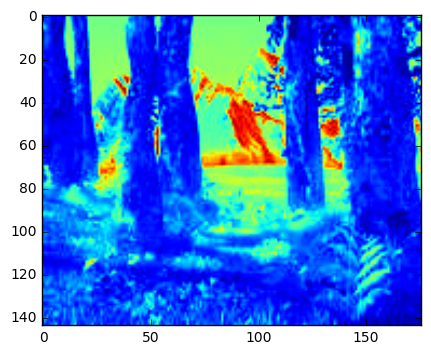

[  1.20401398e-02   1.14603735e-02   1.08742485e-02   1.39447786e-02
   1.01792424e-02   1.01069673e-02   6.99770890e-03   6.42007517e-03
   5.66507302e-03   7.15105392e-03   5.26428396e-03   5.68498987e-03
   5.12033486e-03   4.53550362e-03   3.75566174e-03   4.69436654e-03
   3.48270694e-03   4.11765012e-03   6.46849380e-03   5.73456120e-03
   5.10631399e-03   8.97329433e-03   4.85551375e-03   4.71354583e-03
   1.84392554e-03   1.57016172e-03   1.35143992e-03   2.23036174e-03
   1.28179712e-03   1.31765593e-03   9.18992939e-04   7.49737122e-04
   6.63273734e-04   1.02065396e-03   5.80286909e-04   6.55741647e-04
   1.16525443e+00   2.33050886e+00   3.49576324e+00   4.66088286e+00
   5.82627215e-01   2.91313608e-01   1.94208973e-01   1.45569266e-01
   1.94208973e-01   8.94789401e-02   2.84217530e-02   2.15961663e-03]


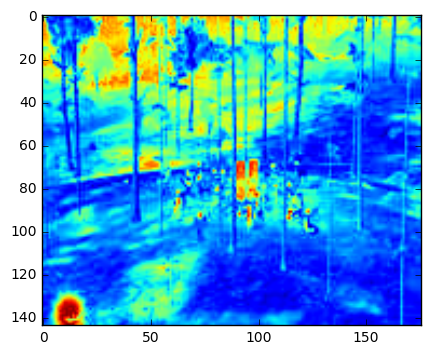

[  1.35948529e-02   1.27064321e-02   1.24072731e-02   1.37045102e-02
   1.21009859e-02   1.31417747e-02   7.59002476e-03   6.60237046e-03
   6.66737449e-03   7.38356386e-03   6.62160126e-03   7.18768207e-03
   5.06681689e-03   4.19418456e-03   5.05812355e-03   5.43668838e-03
   5.26834878e-03   4.92111211e-03   7.51443190e-03   6.84273880e-03
   6.41302278e-03   8.09817574e-03   6.31871859e-03   7.26281575e-03
   2.10213826e-03   1.78830680e-03   1.50675415e-03   1.98262381e-03
   1.37575132e-03   1.90506731e-03   1.04648756e-03   7.80005476e-04
   7.01135283e-04   8.15823709e-04   6.57719450e-04   8.93434166e-04
   1.46388922e+00   2.92777845e+00   4.39166761e+00   5.85538747e+00
   7.31944612e-01   3.65972306e-01   2.43981413e-01   1.82876180e-01
   2.43981413e-01   1.12410863e-01   3.57057625e-02   2.35657226e-03]


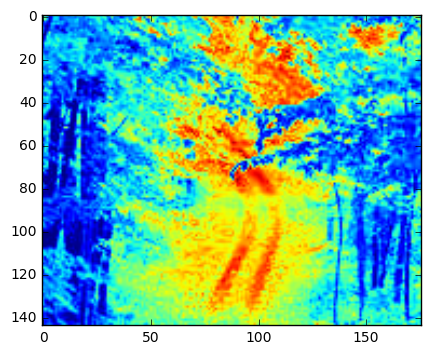

[  1.14554381e-02   9.38349153e-03   7.79425197e-03   7.35116655e-03
   8.20447442e-03   1.01619802e-02   6.92496774e-03   5.61103387e-03
   5.13968882e-03   4.76807930e-03   5.11975472e-03   5.62228058e-03
   4.78303220e-03   4.04673706e-03   3.77736073e-03   3.61362303e-03
   3.85002831e-03   4.08945979e-03   6.02819077e-03   4.06387983e-03
   3.28833271e-03   3.37167813e-03   3.62091491e-03   4.91800442e-03
   2.02717124e-03   1.29850956e-03   1.18525041e-03   1.11414963e-03
   1.13797181e-03   1.41145182e-03   9.61353212e-04   6.30634433e-04
   6.89052498e-04   6.09184701e-04   6.12398263e-04   6.66575076e-04
   1.54204478e+00   3.08408956e+00   4.62613428e+00   6.16800066e+00
   7.71022391e-01   3.85511195e-01   2.57007333e-01   1.92639754e-01
   2.57007333e-01   1.18412365e-01   3.76120569e-02   2.60487954e-03]


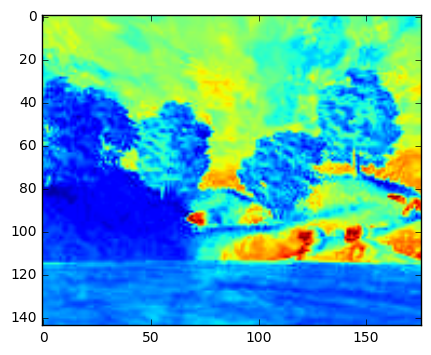

[  7.86856778e-03   8.33925610e-03   1.05297475e-02   1.30081019e-02
   1.00852488e-02   8.24591658e-03   5.60321458e-03   5.52656892e-03
   6.55904247e-03   8.34577484e-03   6.87905824e-03   5.84365523e-03
   4.43611825e-03   4.26606004e-03   5.06326899e-03   6.19979106e-03
   5.57494280e-03   4.76895715e-03   3.21158517e-03   3.13546718e-03
   4.31941914e-03   6.09647198e-03   3.54924776e-03   2.97154170e-03
   1.04499252e-03   9.83068738e-04   1.32709114e-03   2.09285012e-03
   1.08999164e-03   8.99943597e-04   5.59597751e-04   5.33188232e-04
   6.91184590e-04   1.01394856e-03   5.97353638e-04   4.96413181e-04
   1.19002758e+00   2.38005516e+00   3.57008270e+00   4.75997260e+00
   5.95013791e-01   2.97506896e-01   1.98337830e-01   1.48664049e-01
   1.98337830e-01   9.13812503e-02   2.90259957e-02   2.12276970e-03]


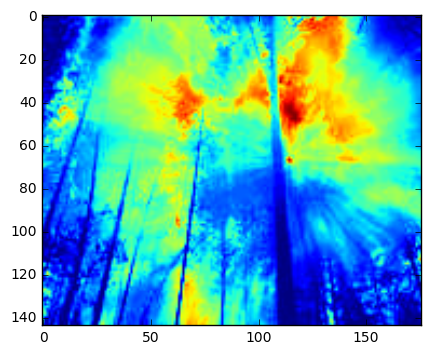

[  7.53070176e-03   8.32324749e-03   1.13006839e-02   1.45049927e-02
   1.17295205e-02   8.72367061e-03   4.68790443e-03   5.20626012e-03
   7.02729333e-03   9.33859654e-03   7.35216404e-03   5.43862761e-03
   3.66751049e-03   4.00632970e-03   5.41988169e-03   6.88934664e-03
   5.50473114e-03   4.09250300e-03   3.56805258e-03   3.54375526e-03
   4.78823530e-03   7.60806216e-03   4.87750815e-03   3.50916557e-03
   9.79553410e-04   9.59667103e-04   1.35802133e-03   2.53364047e-03
   1.48754656e-03   1.00215918e-03   4.73879757e-04   4.92110930e-04
   7.05616633e-04   1.21455902e-03   7.93109101e-04   5.29664729e-04
   1.43535909e+00   2.87071818e+00   4.30607721e+00   5.74127024e+00
   7.17679544e-01   3.58839772e-01   2.39226393e-01   1.79312057e-01
   2.39226393e-01   1.10220057e-01   3.50098832e-02   2.56991422e-03]


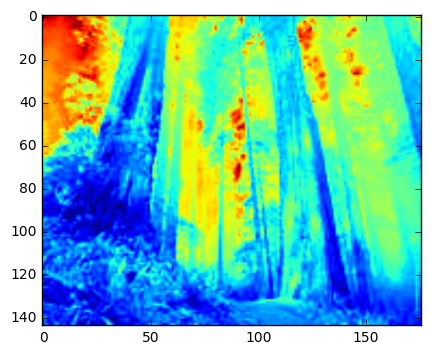

[  1.13693288e-02   1.31296904e-02   1.96417871e-02   2.99660453e-02
   1.95879112e-02   1.23346445e-02   6.73781988e-03   7.00654495e-03
   9.25280188e-03   1.56157324e-02   8.58221069e-03   6.62340742e-03
   5.15748107e-03   5.14008216e-03   6.16848981e-03   8.97010532e-03
   5.23608067e-03   4.98564565e-03   6.00413014e-03   6.28902077e-03
   9.00396623e-03   1.83129690e-02   8.90722965e-03   6.02682700e-03
   1.60900745e-03   1.57815242e-03   2.22574883e-03   5.75067627e-03
   2.21095108e-03   1.50202876e-03   7.44666138e-04   6.81116117e-04
   1.02102525e-03   2.34522208e-03   8.52424104e-04   7.14495852e-04
   1.32262869e+00   2.64525739e+00   3.96788603e+00   5.29036171e+00
   6.61314347e-01   3.30657174e-01   2.20438004e-01   1.65229226e-01
   2.20438004e-01   1.01563582e-01   3.22602731e-02   2.49728615e-03]


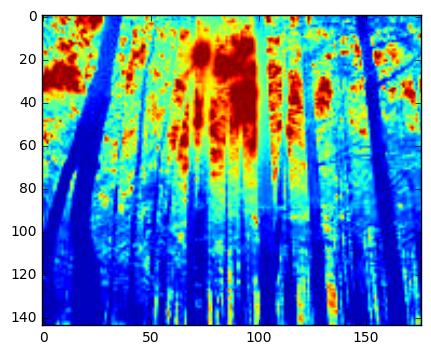

[  1.29483195e-02   1.13325463e-02   1.29326159e-02   1.69303591e-02
   1.25587171e-02   1.24566325e-02   6.15569415e-03   5.40671131e-03
   5.89501159e-03   7.50712974e-03   5.94307866e-03   5.64652551e-03
   3.95697047e-03   3.69549365e-03   3.93179843e-03   4.65855680e-03
   3.81379300e-03   3.67860050e-03   8.11114943e-03   6.39203506e-03
   7.24946688e-03   1.14897321e-02   6.66743123e-03   7.25205755e-03
   1.88988609e-03   1.44539684e-03   1.70427564e-03   2.57108602e-03
   1.63554876e-03   1.62801055e-03   7.57189835e-04   5.87423772e-04
   6.76280621e-04   1.02992402e-03   7.28825174e-04   6.72843139e-04
   1.49649437e+00   2.99298874e+00   4.48948305e+00   5.98580429e+00
   7.48247185e-01   3.74123592e-01   2.49415602e-01   1.86949374e-01
   2.49415602e-01   1.14914586e-01   3.65010355e-02   2.18756843e-03]


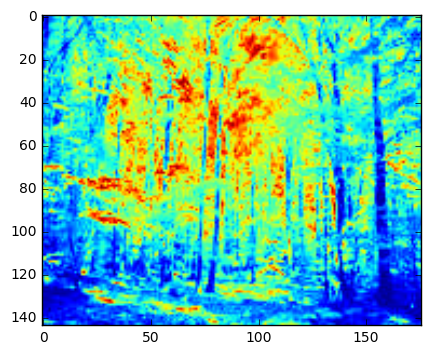

[  1.75667855e-02   1.31990199e-02   8.88892850e-03   7.52008407e-03
   9.16452064e-03   1.38585406e-02   1.15595315e-02   8.42254563e-03
   6.07497816e-03   5.72903947e-03   6.32284388e-03   8.92268057e-03
   8.44090044e-03   6.22100082e-03   4.80766233e-03   4.77375081e-03
   5.05255217e-03   6.47430282e-03   8.78510739e-03   4.83060023e-03
   2.67104303e-03   2.71478407e-03   2.85210517e-03   4.98127305e-03
   3.06514077e-03   1.63261886e-03   9.37062680e-04   1.02302181e-03
   1.06025400e-03   1.80265386e-03   1.57608261e-03   8.95302447e-04
   5.33593257e-04   5.92245602e-04   6.25739923e-04   1.00200434e-03
   1.69189022e+00   3.38378045e+00   5.07567060e+00   6.76736509e+00
   8.45945112e-01   4.22972556e-01   2.81981561e-01   2.11359177e-01
   2.81981561e-01   1.29918874e-01   4.12669412e-02   3.07321247e-03]


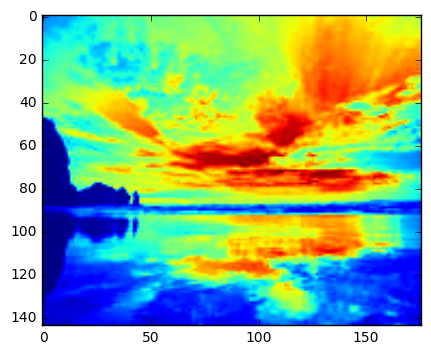

[  1.72343929e-02   1.38793141e-02   1.02469048e-02   8.60332951e-03
   9.66416596e-03   1.37495217e-02   1.19283871e-02   9.57199075e-03
   7.48656251e-03   6.87270455e-03   6.89125833e-03   9.16306042e-03
   8.78275098e-03   7.55455780e-03   6.12167434e-03   5.77763183e-03
   5.71237399e-03   7.05528141e-03   7.50283020e-03   4.91242167e-03
   3.07532932e-03   2.93214150e-03   3.18656307e-03   4.87177558e-03
   3.04110973e-03   1.98300105e-03   1.24018855e-03   1.24713797e-03
   1.24604790e-03   1.85706838e-03   1.61540261e-03   1.11993607e-03
   7.20115578e-04   7.11816021e-04   7.43078788e-04   1.00952225e-03
   1.80021754e+00   3.60043508e+00   5.40065254e+00   7.20066181e+00
   9.00108769e-01   4.50054384e-01   3.00036104e-01   2.24891953e-01
   3.00036104e-01   1.38237241e-01   4.39091557e-02   3.45182227e-03]


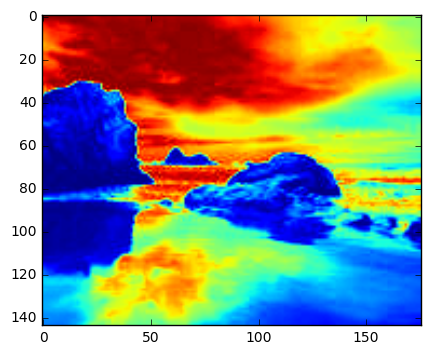

[  2.04108798e-02   1.46574528e-02   8.98233321e-03   6.75423660e-03
   1.03558007e-02   1.65200174e-02   1.48837385e-02   9.71036924e-03
   5.67417759e-03   4.51230826e-03   6.29175083e-03   1.13644226e-02
   1.12563375e-02   7.16897974e-03   4.20403372e-03   3.46461140e-03
   4.42662858e-03   8.29293562e-03   9.50342578e-03   4.72970546e-03
   2.58556851e-03   2.83115001e-03   3.14980580e-03   5.51419294e-03
   3.61700126e-03   1.68546577e-03   8.46133423e-04   9.45590880e-04
   1.11653299e-03   2.08280352e-03   2.02475823e-03   8.94087032e-04
   4.50022442e-04   4.83145738e-04   5.83592934e-04   1.14651058e-03
   1.13052946e+00   2.26105893e+00   3.39158834e+00   4.52198702e+00
   5.65264732e-01   2.82632366e-01   1.88421482e-01   1.41231254e-01
   1.88421482e-01   8.68124381e-02   2.75747754e-02   3.08318925e-03]


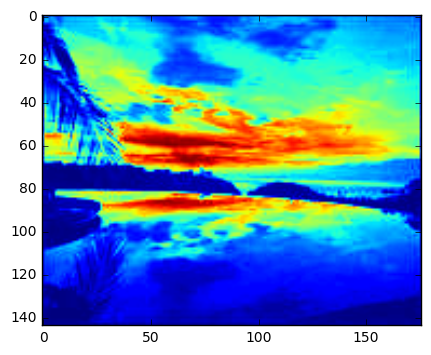

[  1.36895917e-02   9.94519797e-03   6.41889777e-03   5.22309919e-03
   7.35655067e-03   1.11749279e-02   9.81716662e-03   6.70511351e-03
   4.25353155e-03   3.38292615e-03   4.80758062e-03   7.19248248e-03
   7.24012110e-03   5.27630451e-03   3.13736745e-03   2.48728411e-03
   3.40519217e-03   5.37863701e-03   6.68530978e-03   3.50089310e-03
   2.14296792e-03   2.15964663e-03   2.44584930e-03   4.11473500e-03
   2.67138126e-03   1.33065875e-03   7.45391897e-04   7.48326596e-04
   9.43397465e-04   1.49452760e-03   1.46750395e-03   7.48558660e-04
   3.82850083e-04   3.83972245e-04   5.22868116e-04   7.72700505e-04
   6.88953883e-01   1.37790777e+00   2.06686162e+00   2.75573580e+00
   3.44482221e-01   1.72242851e-01   1.14828615e-01   8.60751520e-02
   1.14828615e-01   5.29042084e-02   1.68569257e-02   2.08134945e-03]


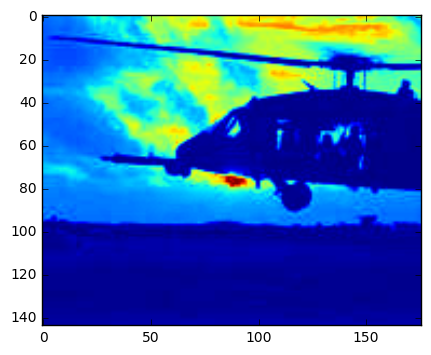

[  1.27505553e-02   9.29596673e-03   1.08862116e-02   1.55079831e-02
   1.04724069e-02   8.91059864e-03   6.04620706e-03   4.66782956e-03
   4.74737824e-03   8.68243730e-03   4.32427038e-03   4.25215625e-03
   4.01449193e-03   3.37831996e-03   3.52468258e-03   4.66122525e-03
   3.12819850e-03   3.08600247e-03   9.18715969e-03   4.85183618e-03
   4.66663718e-03   8.84902991e-03   4.50061177e-03   4.51244542e-03
   1.99558292e-03   1.10951137e-03   1.09034521e-03   3.33044883e-03
   1.04156076e-03   9.62207268e-04   7.52490426e-04   5.26154786e-04
   5.09926147e-04   1.28332481e-03   4.56140206e-04   4.63510722e-04
   1.19757329e+00   2.39514658e+00   3.59271982e+00   4.79015457e+00
   5.98786646e-01   2.99393323e-01   1.99595447e-01   1.49606695e-01
   1.99595447e-01   9.19606791e-02   2.92100432e-02   1.99910720e-03]


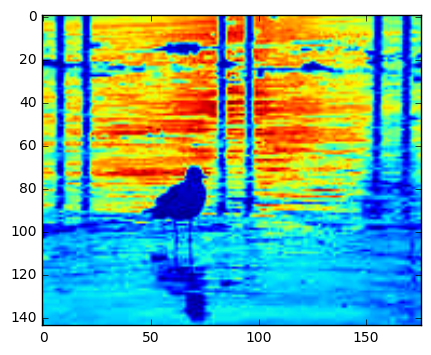

[  8.78905828e-03   7.81891713e-03   5.32835731e-03   2.74161140e-03
   3.82878654e-03   6.86239329e-03   8.00869248e-03   7.22951969e-03
   4.74696932e-03   2.11631212e-03   3.36671789e-03   6.23719451e-03
   7.25866730e-03   6.86297856e-03   3.91415014e-03   1.80061624e-03
   2.74123717e-03   5.96893721e-03   3.07408282e-03   1.73323993e-03
   8.46610135e-04   9.20787563e-04   7.82181445e-04   1.58969816e-03
   1.48312101e-03   8.20080212e-04   3.19628556e-04   2.70328322e-04
   2.99085445e-04   7.17807242e-04   9.36192323e-04   6.17912040e-04
   2.36843890e-04   1.38709652e-04   2.23412976e-04   5.37055291e-04
   1.24077276e+00   2.48154552e+00   3.72231823e+00   4.96294745e+00
   6.20386380e-01   3.10193190e-01   2.06795355e-01   1.55003384e-01
   2.06795355e-01   9.52779313e-02   3.02637227e-02   2.77793271e-03]


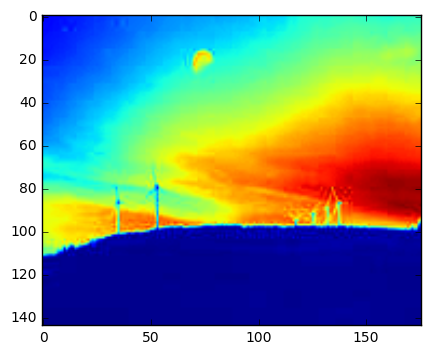

[  1.20589826e-02   1.21249894e-02   1.14358686e-02   9.60409823e-03
   9.20421483e-03   1.02030607e-02   7.78088768e-03   7.42440385e-03
   7.12134566e-03   6.91114939e-03   6.24444480e-03   6.48365093e-03
   5.65817100e-03   5.25397868e-03   5.60718761e-03   5.64504590e-03
   5.03026763e-03   4.90060622e-03   5.60538410e-03   5.13118732e-03
   5.27492217e-03   3.67790781e-03   3.47692738e-03   4.19696466e-03
   1.91969440e-03   1.68117596e-03   1.50714041e-03   1.22993874e-03
   1.17191608e-03   1.40135401e-03   1.00655599e-03   8.29862253e-04
   7.71653119e-04   6.86315620e-04   6.87021720e-04   7.43104915e-04
   1.33282015e+00   2.66564029e+00   3.99846038e+00   5.33112634e+00
   6.66410073e-01   3.33205037e-01   2.22136578e-01   1.66502392e-01
   2.22136578e-01   1.02346175e-01   3.25088530e-02   2.56193367e-03]


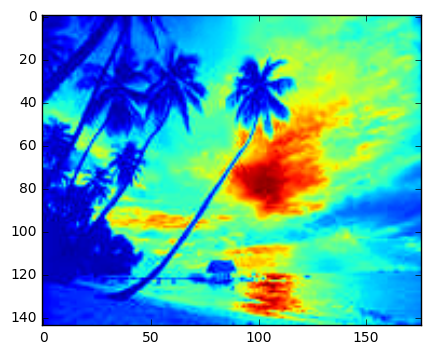

[  1.20973641e-02   7.85068170e-03   4.13031909e-03   2.86512756e-03
   5.24073375e-03   9.15235457e-03   8.47164235e-03   5.44353476e-03
   2.93561652e-03   2.10976719e-03   3.73962480e-03   6.55724117e-03
   6.63598400e-03   4.58670820e-03   2.27873833e-03   1.69453748e-03
   2.85390545e-03   5.56734814e-03   6.13726110e-03   2.32491851e-03
   1.04668927e-03   1.22747180e-03   1.19958914e-03   3.01718824e-03
   1.91742502e-03   7.19901759e-04   2.96275593e-04   3.56218256e-04
   3.74949984e-04   1.01660539e-03   9.86868982e-04   4.56871422e-04
   2.11818849e-04   1.72036517e-04   2.60213231e-04   6.78393830e-04
   1.15888179e+00   2.31776358e+00   3.47664531e+00   4.63539303e+00
   5.79440894e-01   2.89720447e-01   1.93146867e-01   1.44773164e-01
   1.93146867e-01   8.89895901e-02   2.82663177e-02   2.33058196e-03]


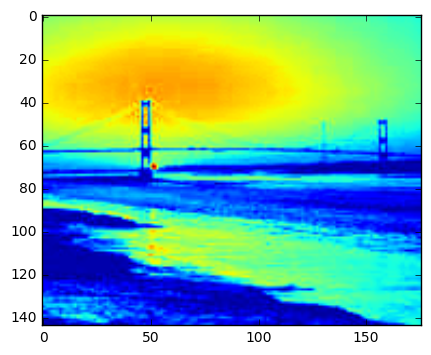

[  1.45157330e-02   1.07303696e-02   5.89472614e-03   2.68781755e-03
   5.45118170e-03   1.03690892e-02   9.64315579e-03   7.30072763e-03
   3.93479911e-03   1.51009186e-03   3.46337294e-03   6.90877967e-03
   7.63017775e-03   6.09629913e-03   2.82122119e-03   1.13151639e-03
   2.42333353e-03   5.76688620e-03   7.54702404e-03   3.82341611e-03
   1.61716405e-03   1.21020289e-03   1.62722695e-03   3.69338623e-03
   2.41466912e-03   1.27008737e-03   4.60828983e-04   3.09425614e-04
   4.34253990e-04   1.17146187e-03   1.25816810e-03   6.59525289e-04
   2.52548372e-04   1.45695742e-04   2.23819026e-04   6.04913859e-04
   1.34740110e+00   2.69480220e+00   4.04220324e+00   5.38944847e+00
   6.73700550e-01   3.36850275e-01   2.24566736e-01   1.68323916e-01
   2.24566736e-01   1.03465835e-01   3.28644975e-02   2.74115926e-03]


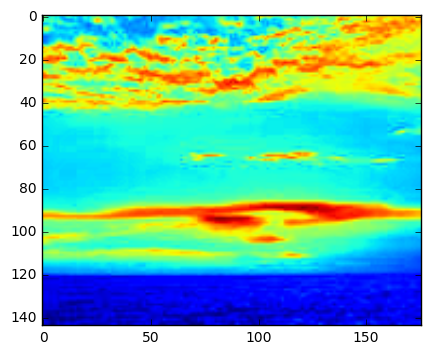

[  9.71527171e-03   8.22684854e-03   1.00221978e-02   1.19594684e-02
   9.49292576e-03   8.27980411e-03   6.25833833e-03   5.47470818e-03
   6.89687473e-03   9.25810190e-03   6.00157425e-03   5.13891773e-03
   4.55951632e-03   4.36130219e-03   5.28093228e-03   6.92185785e-03
   4.27174345e-03   3.96103362e-03   4.60047803e-03   2.55005757e-03
   3.04401413e-03   4.82691560e-03   2.95097918e-03   2.72710208e-03
   1.45170809e-03   7.91123414e-04   1.06016940e-03   2.08341157e-03
   1.01666591e-03   8.47509239e-04   7.30413501e-04   4.97738281e-04
   6.12684167e-04   1.17120731e-03   5.78040840e-04   5.35915853e-04
   1.64013683e+00   3.28027365e+00   4.92041041e+00   6.56035749e+00
   8.20068413e-01   4.10034207e-01   2.73355999e-01   2.04893890e-01
   2.73355999e-01   1.25944773e-01   4.00046227e-02   2.95601497e-03]


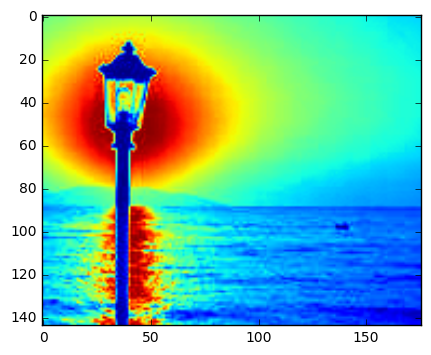

[  1.60497209e-02   1.06434922e-02   5.34788534e-03   2.82834710e-03
   5.26459191e-03   1.07794107e-02   1.03820428e-02   6.41760255e-03
   3.11520314e-03   2.12363352e-03   3.02977784e-03   6.36754721e-03
   7.34276509e-03   4.39436386e-03   2.28825008e-03   1.74395335e-03
   2.28991537e-03   4.33952814e-03   9.02180466e-03   3.66194563e-03
   1.22668391e-03   9.78450299e-04   1.33418298e-03   3.95142404e-03
   3.25226500e-03   1.28572769e-03   4.29079896e-04   3.58630041e-04
   4.28646345e-04   1.30375142e-03   1.64786796e-03   6.32028880e-04
   2.55648710e-04   1.97878320e-04   2.42622159e-04   6.33185084e-04
   9.32453604e-01   1.86490721e+00   2.79736077e+00   3.72970650e+00
   4.66226802e-01   2.33113401e-01   1.55408855e-01   1.16486651e-01
   1.55408855e-01   7.16023540e-02   2.27435016e-02   1.76935332e-03]


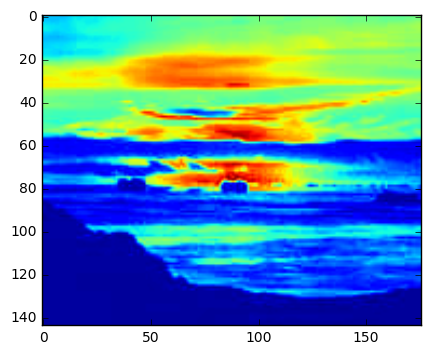

[  8.04419654e-03   6.50379869e-03   4.33602146e-03   3.40181165e-03
   4.41955024e-03   6.60114544e-03   6.51367519e-03   5.23140211e-03
   3.49406736e-03   2.88682890e-03   3.59267406e-03   5.28877324e-03
   5.50118649e-03   4.71224349e-03   2.91797325e-03   2.56535784e-03
   3.03258866e-03   4.84604181e-03   2.79169601e-03   1.71595207e-03
   9.99595965e-04   9.41523810e-04   1.01933831e-03   1.74078834e-03
   1.07196998e-03   5.99901435e-04   3.48443621e-04   3.29250481e-04
   3.64099421e-04   6.10146565e-04   6.06472597e-04   3.59581845e-04
   2.25442678e-04   1.88593448e-04   2.34328237e-04   3.63622445e-04
   1.04044957e+00   2.08089914e+00   3.12134867e+00   4.16167787e+00
   5.20224785e-01   2.60112393e-01   1.73408174e-01   1.29978034e-01
   1.73408174e-01   7.98952764e-02   2.53776342e-02   1.65384223e-03]


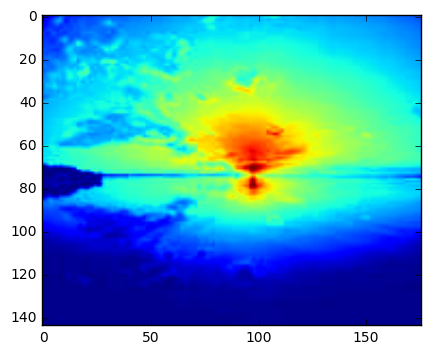

[  1.49112628e-02   1.11467343e-02   6.95624240e-03   4.95020078e-03
   7.13906467e-03   1.14968573e-02   1.12456784e-02   8.57574486e-03
   5.14540993e-03   3.48296001e-03   5.32098695e-03   8.97911758e-03
   9.28747801e-03   7.52319338e-03   4.00951450e-03   2.75375512e-03
   4.03812526e-03   7.69805393e-03   7.34234243e-03   3.70192280e-03
   2.22456929e-03   1.92250129e-03   2.13135678e-03   3.86235660e-03
   2.58057443e-03   1.39531685e-03   8.23562215e-04   7.04592515e-04
   8.12843064e-04   1.52681018e-03   1.49729524e-03   8.30909743e-04
   4.64129681e-04   3.82300045e-04   4.71523140e-04   9.38952139e-04
   1.55630840e+00   3.11261681e+00   4.66892515e+00   6.22505350e+00
   7.78154202e-01   3.89077101e-01   2.59384602e-01   1.94421635e-01
   2.59384602e-01   1.19507657e-01   3.79599613e-02   3.20016199e-03]


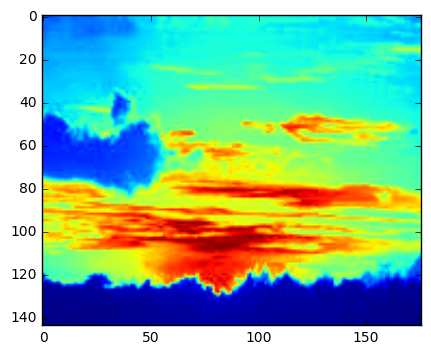

[  1.01136626e-02   8.91712141e-03   7.13560221e-03   6.23945047e-03
   6.77779953e-03   8.41240092e-03   6.99538259e-03   6.21851378e-03
   5.03562457e-03   4.82959880e-03   5.03348835e-03   5.75121694e-03
   5.22979621e-03   5.04215307e-03   3.98325254e-03   4.02784524e-03
   4.16769733e-03   4.59730304e-03   4.28752345e-03   3.56447690e-03
   2.53557977e-03   2.13444506e-03   2.28523793e-03   3.06542117e-03
   1.63101900e-03   1.27118536e-03   9.50634523e-04   8.01804866e-04
   8.73311355e-04   1.14492859e-03   8.53926204e-04   7.09908695e-04
   5.23983096e-04   4.63256801e-04   5.13080962e-04   6.50109577e-04
   7.87588909e-01   1.57517782e+00   2.36276669e+00   3.15026449e+00
   3.93794454e-01   1.96897227e-01   1.31264752e-01   9.83894471e-02
   1.31264752e-01   6.04783118e-02   1.92189450e-02   1.86455567e-03]


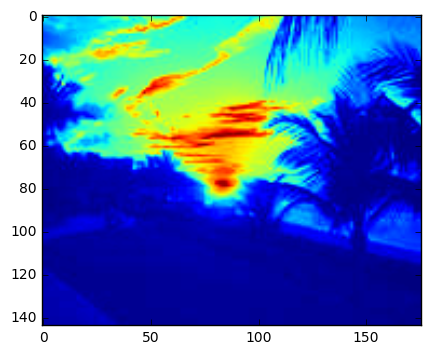

[  1.86225363e-02   1.24145082e-02   7.28524779e-03   6.36694554e-03
   1.04774879e-02   1.58314679e-02   1.20681213e-02   6.57095344e-03
   3.34027866e-03   3.37654015e-03   5.31691681e-03   8.90198601e-03
   8.17174143e-03   4.04845722e-03   2.06044986e-03   2.17833236e-03
   3.16501489e-03   5.61554878e-03   9.22040305e-03   4.61589576e-03
   2.77116318e-03   2.91838527e-03   4.00564019e-03   6.32807581e-03
   3.49170017e-03   1.45149099e-03   7.58350178e-04   9.13356855e-04
   1.33142401e-03   2.07919174e-03   1.88248237e-03   6.64723740e-04
   3.82536095e-04   4.45660980e-04   6.45581931e-04   1.02476666e-03
   1.38997265e+00   2.77994530e+00   4.16991790e+00   5.55972974e+00
   6.94986326e-01   3.47493163e-01   2.31661991e-01   1.73642162e-01
   2.31661991e-01   1.06734870e-01   3.39028614e-02   2.48461213e-03]


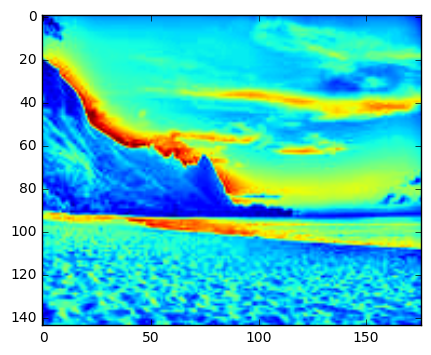

[  1.78355421e-02   1.39174285e-02   8.99647276e-03   6.93578554e-03
   9.41151457e-03   1.40640543e-02   1.34036334e-02   9.37553742e-03
   5.72182633e-03   4.87967487e-03   5.91154424e-03   9.32683458e-03
   1.02667696e-02   7.32099103e-03   4.23223032e-03   3.77044302e-03
   4.23127757e-03   7.09199572e-03   8.80063921e-03   5.05495388e-03
   3.07472653e-03   2.90795299e-03   3.15597978e-03   5.13555846e-03
   3.46703567e-03   1.76288087e-03   1.02849886e-03   1.10983202e-03
   1.09278973e-03   1.79424706e-03   1.93714433e-03   9.14657672e-04
   5.80161191e-04   6.25212659e-04   5.86435224e-04   9.45521335e-04
   1.30026310e+00   2.60052620e+00   3.90078925e+00   5.20090193e+00
   6.50131551e-01   3.25065776e-01   2.16710407e-01   1.62435207e-01
   2.16710407e-01   9.98461462e-02   3.17490121e-02   3.06060862e-03]


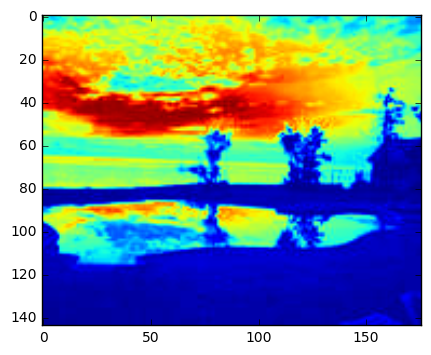

[  8.07586522e-03   6.88026412e-03   5.36395778e-03   4.78208984e-03
   5.15642117e-03   6.56271150e-03   5.35293274e-03   4.91997511e-03
   3.90923114e-03   3.60596081e-03   3.75112762e-03   4.47140841e-03
   4.08729437e-03   3.96611887e-03   3.15746154e-03   2.99303304e-03
   3.00448801e-03   3.60586863e-03   3.54020301e-03   2.26588157e-03
   1.48501092e-03   1.48336702e-03   1.60405489e-03   2.44869963e-03
   1.20287595e-03   8.75692113e-04   5.41708369e-04   5.81551435e-04
   6.39319775e-04   8.35604032e-04   6.02562615e-04   5.33227053e-04
   3.08520526e-04   3.41439986e-04   3.88167028e-04   4.70483949e-04
   9.23145942e-01   1.84629188e+00   2.76943779e+00   3.69247693e+00
   4.61572971e-01   2.30786486e-01   1.53857579e-01   1.15323893e-01
   1.53857579e-01   7.08876262e-02   2.25164782e-02   1.64338463e-03]


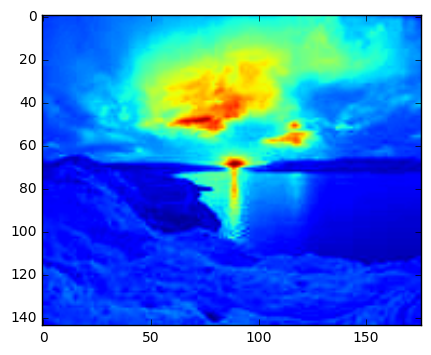

[  1.65903762e-02   1.56759507e-02   1.34967506e-02   1.32228938e-02
   1.24166657e-02   1.39644718e-02   1.16459223e-02   9.92431657e-03
   7.25442596e-03   7.38818269e-03   6.73679167e-03   8.63017369e-03
   8.81161870e-03   7.05922924e-03   4.50977878e-03   4.60482951e-03
   4.44934898e-03   6.25623744e-03   7.71330940e-03   6.76224726e-03
   6.14709103e-03   7.22524798e-03   5.51502525e-03   6.15506579e-03
   2.70741240e-03   2.25147098e-03   1.90007447e-03   2.30881342e-03
   1.72533385e-03   1.90296888e-03   1.54665408e-03   1.17925710e-03
   8.32091984e-04   1.08570899e-03   7.52649591e-04   9.36491468e-04
   8.65829782e-01   1.73165956e+00   2.59748931e+00   3.46321892e+00
   4.32914891e-01   2.16458047e-01   1.44304890e-01   1.08163679e-01
   1.44304890e-01   6.64863648e-02   2.11831096e-02   2.89026013e-03]


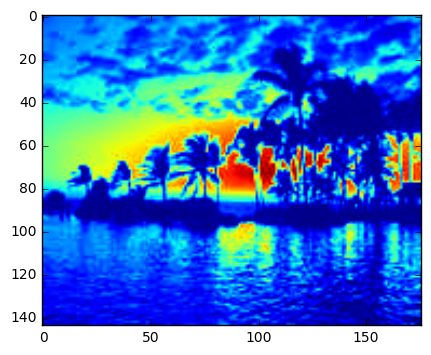

[  7.58984190e-03   5.99926406e-03   3.57305959e-03   2.57866338e-03
   3.68238792e-03   5.85560180e-03   6.21115036e-03   4.94057964e-03
   2.93896665e-03   2.15137914e-03   3.16193135e-03   5.02002893e-03
   5.32109728e-03   4.65092448e-03   2.45009800e-03   1.86686619e-03
   2.64781387e-03   4.65909819e-03   2.71993711e-03   1.67223833e-03
   7.79626901e-04   5.60037985e-04   7.16341959e-04   1.55438987e-03
   1.12736873e-03   6.77689452e-04   3.20216654e-04   2.29392227e-04
   2.91215381e-04   6.50307853e-04   6.68916847e-04   4.78606683e-04
   2.47117129e-04   1.38729312e-04   2.34973890e-04   4.71037553e-04
   1.22527544e+00   2.45055089e+00   3.67582628e+00   4.90095997e+00
   6.12637722e-01   3.06318861e-01   2.04212470e-01   1.53067384e-01
   2.04212470e-01   9.40879049e-02   2.98857272e-02   2.15970781e-03]


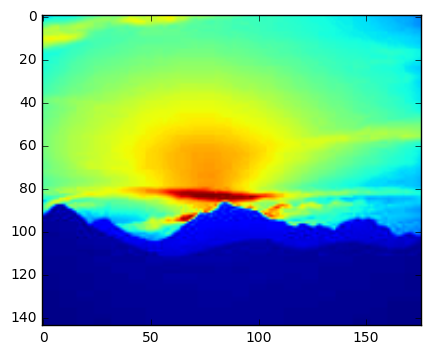

[  7.53426020e-03   6.71132591e-03   5.54411869e-03   4.98889309e-03
   5.41880761e-03   6.65501382e-03   6.63991537e-03   5.74471642e-03
   4.72037824e-03   4.12501976e-03   4.53942378e-03   5.79640535e-03
   5.83284467e-03   5.15979978e-03   3.96032113e-03   3.50652240e-03
   3.86360753e-03   5.24784126e-03   1.84441038e-03   1.87372717e-03
   1.70637318e-03   1.29168899e-03   1.54914459e-03   1.64877501e-03
   8.82761083e-04   8.72416456e-04   7.95275081e-04   5.91187077e-04
   6.85592794e-04   7.67382969e-04   5.79869111e-04   5.59034417e-04
   5.13538954e-04   3.88444629e-04   4.35955138e-04   5.17325739e-04
   7.46615415e-01   1.49323083e+00   2.23984621e+00   2.98637525e+00
   3.73307707e-01   1.86653854e-01   1.24435839e-01   9.32708384e-02
   1.24435839e-01   5.73319905e-02   1.82107172e-02   2.15927558e-03]


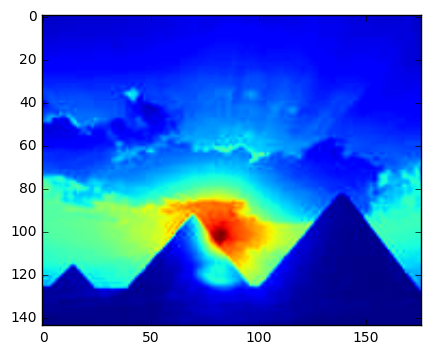

[  1.19784354e-02   8.54964576e-03   4.44074320e-03   2.92091769e-03
   4.95033550e-03   8.65491514e-03   8.63994105e-03   5.90989773e-03
   2.96784714e-03   2.40388570e-03   3.69330933e-03   6.28569317e-03
   6.77615071e-03   4.94201314e-03   2.32552758e-03   2.15471747e-03
   3.00566469e-03   5.33183072e-03   6.12890336e-03   2.88815996e-03
   1.04031118e-03   7.95956444e-04   9.41894599e-04   2.48992872e-03
   2.14552824e-03   9.37214758e-04   3.03657244e-04   2.25786473e-04
   2.86759936e-04   8.18290336e-04   1.08197530e-03   5.46138655e-04
   2.58889499e-04   1.30430820e-04   2.65609043e-04   5.10577842e-04
   1.80131819e+00   3.60263638e+00   5.40395449e+00   7.20506429e+00
   9.00659095e-01   4.50329548e-01   3.00219546e-01   2.25029452e-01
   3.00219546e-01   1.38321759e-01   4.39360018e-02   2.61394442e-03]


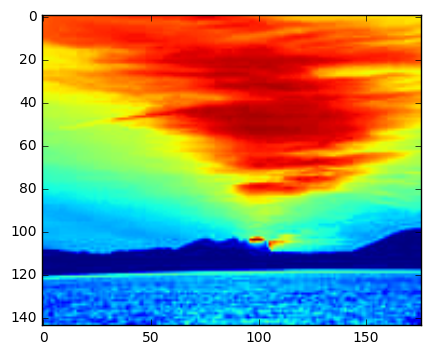

[  4.53691608e-03   4.55614387e-03   5.55358793e-03   6.80181258e-03
   5.90934471e-03   4.83458613e-03   3.69915826e-03   3.36025007e-03
   3.73115891e-03   4.62757284e-03   4.28430702e-03   3.78097796e-03
   3.16841568e-03   2.81899076e-03   3.16129184e-03   3.68639892e-03
   3.64252516e-03   3.25700969e-03   1.35321793e-03   1.45975450e-03
   2.17910216e-03   3.39108459e-03   2.21098679e-03   1.47063749e-03
   5.69662369e-04   4.92442831e-04   6.39574859e-04   9.97695540e-04
   6.55398510e-04   5.20125039e-04   3.79246686e-04   3.15670953e-04
   3.63790122e-04   5.17889007e-04   3.89796752e-04   3.34900025e-04
   1.34450461e+00   2.68900922e+00   4.03351378e+00   5.37786284e+00
   6.72252306e-01   3.36126153e-01   2.24083988e-01   1.67962072e-01
   2.24083988e-01   1.03243416e-01   3.27938491e-02   2.23677110e-03]


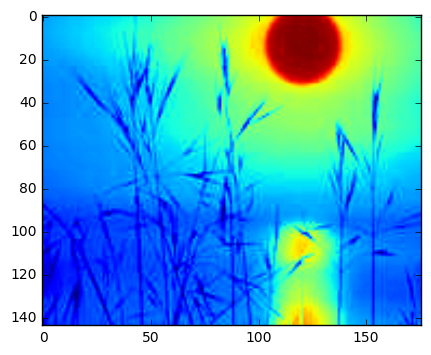

[  7.05708163e-03   6.19809372e-03   4.96583824e-03   4.57831142e-03
   4.99410149e-03   6.15243376e-03   5.95393050e-03   4.99829500e-03
   3.77423803e-03   3.53698621e-03   3.91216218e-03   5.17116088e-03
   5.14758685e-03   4.40575352e-03   2.96401770e-03   2.85551173e-03
   3.15128873e-03   4.61815737e-03   2.53388511e-03   1.68316698e-03
   1.30095825e-03   1.79307532e-03   1.27979435e-03   1.63406190e-03
   1.06276558e-03   6.57048877e-04   4.99894558e-04   6.83636729e-04
   4.91368969e-04   6.79159094e-04   6.39175227e-04   4.11629190e-04
   3.20278320e-04   3.67136856e-04   3.07448090e-04   4.54308239e-04
   6.40499572e-01   1.28099914e+00   1.92149869e+00   2.56192416e+00
   3.20249786e-01   1.60124893e-01   1.06749874e-01   8.00143298e-02
   1.06749874e-01   4.91834412e-02   1.56224428e-02   1.51295651e-03]


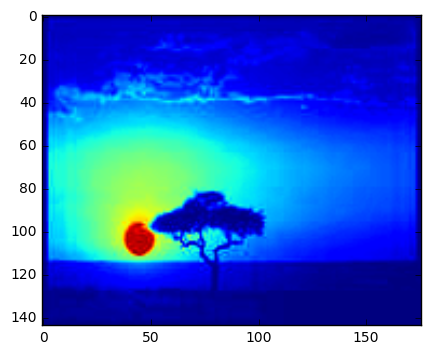

[  1.07649336e-02   8.70436185e-03   5.92658934e-03   4.60787431e-03
   5.76661913e-03   8.68407092e-03   8.50781451e-03   6.35340746e-03
   4.16431259e-03   3.40175368e-03   4.21726694e-03   6.41999095e-03
   6.93856994e-03   5.56691187e-03   3.24609811e-03   2.79893659e-03
   3.45283806e-03   5.62087413e-03   5.19465060e-03   2.87184065e-03
   1.79788858e-03   1.82708832e-03   1.54008652e-03   2.83432644e-03
   2.08340955e-03   9.42481185e-04   5.32979285e-04   5.85564674e-04
   5.30303280e-04   1.01554093e-03   1.17004842e-03   5.58582215e-04
   3.29522037e-04   2.93279210e-04   3.30211954e-04   6.22604673e-04
   1.29792230e+00   2.59584461e+00   3.89376685e+00   5.19153900e+00
   6.48961152e-01   3.24480576e-01   2.16320274e-01   1.62142783e-01
   2.16320274e-01   9.96663981e-02   3.16576588e-02   2.68618804e-03]


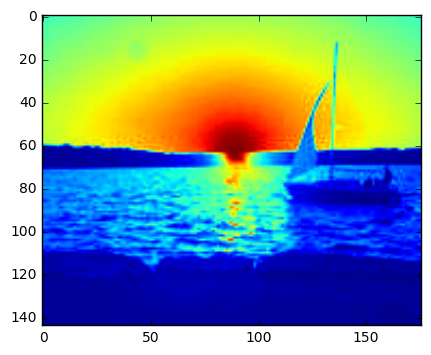

[  1.54760003e-02   1.02100087e-02   5.30566875e-03   4.02911149e-03
   5.31121708e-03   9.78874246e-03   7.95884969e-03   5.26276300e-03
   3.19430115e-03   2.86726676e-03   3.17883616e-03   4.99111992e-03
   5.28303272e-03   4.02725937e-03   2.52795438e-03   2.44142089e-03
   2.59328192e-03   3.81016781e-03   1.00253437e-02   5.06305505e-03
   2.05576778e-03   1.81468129e-03   2.18370053e-03   4.85815484e-03
   2.81747891e-03   1.16557799e-03   4.66215782e-04   4.66031993e-04
   4.84276472e-04   1.08017501e-03   1.09653895e-03   4.86123739e-04
   2.35644760e-04   2.37472637e-04   2.20410281e-04   4.86083046e-04
   5.18513056e-01   1.03702611e+00   1.55553915e+00   2.07399222e+00
   2.59256528e-01   1.29628264e-01   8.64187989e-02   6.47751795e-02
   8.64187989e-02   3.98161959e-02   1.26470663e-02   1.39272588e-03]


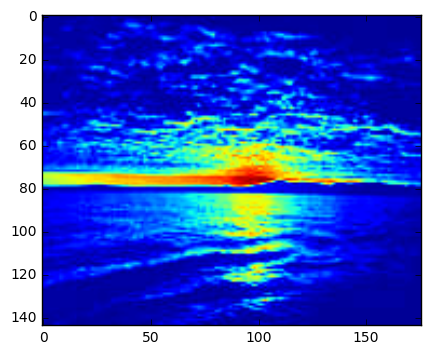

[  8.45148886e-03   6.74760729e-03   4.19273070e-03   2.67690950e-03
   2.91737801e-03   5.17686135e-03   5.70107561e-03   4.97949702e-03
   3.48297538e-03   2.39382125e-03   2.30853975e-03   3.96816119e-03
   4.67883277e-03   4.36988838e-03   3.03269116e-03   2.19703276e-03
   1.92229197e-03   3.55720459e-03   4.22455679e-03   2.16438628e-03
   6.84936051e-04   5.37196257e-04   6.54613740e-04   1.56837873e-03
   1.25384774e-03   7.06697584e-04   2.50458760e-04   1.96765426e-04
   2.21289918e-04   4.68853023e-04   6.28084919e-04   3.94962211e-04
   2.02777057e-04   1.24679296e-04   1.98491026e-04   2.80101771e-04
   1.54152204e+00   3.08304409e+00   4.62456606e+00   6.16590977e+00
   7.70761022e-01   3.85380511e-01   2.56920210e-01   1.92574451e-01
   2.56920210e-01   1.18372224e-01   3.75993068e-02   2.16682162e-03]


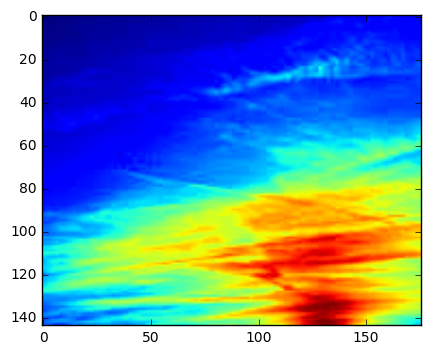

[  2.30064196e-02   1.68509033e-02   9.18950164e-03   6.43061440e-03
   9.94468969e-03   1.76181281e-02   1.72293071e-02   1.11176718e-02
   6.59490374e-03   5.44416180e-03   6.72565399e-03   1.19736414e-02
   1.27231412e-02   8.57344049e-03   5.38394492e-03   4.84823250e-03
   5.35584327e-03   9.03140444e-03   9.58674213e-03   4.51814438e-03
   1.68855756e-03   1.45347962e-03   1.97942774e-03   5.17665887e-03
   4.09357411e-03   1.77280955e-03   6.26376201e-04   5.46605716e-04
   7.36160393e-04   2.15748796e-03   2.37857040e-03   1.01411545e-03
   4.52751209e-04   3.47523937e-04   4.98933337e-04   1.26858495e-03
   1.72998965e+00   3.45997929e+00   5.18996887e+00   6.91975837e+00
   8.64994823e-01   4.32497412e-01   2.88331462e-01   2.16118743e-01
   2.88331462e-01   1.32844498e-01   4.21962253e-02   3.74726427e-03]


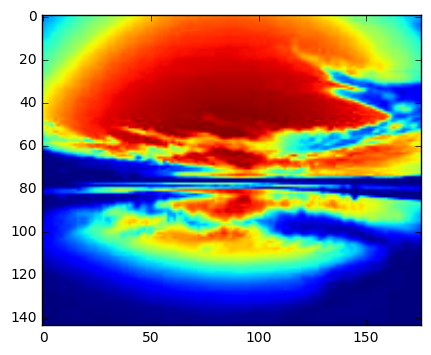

[  7.43035565e-03   6.07134251e-03   3.95256913e-03   2.29552749e-03
   4.04828583e-03   6.45514548e-03   6.89891684e-03   5.71298493e-03
   3.25997765e-03   1.57918718e-03   3.52558105e-03   6.04087023e-03
   6.41011943e-03   5.55560019e-03   2.52686682e-03   1.26979537e-03
   2.82017555e-03   5.86308543e-03   2.23413518e-03   1.35095118e-03
   1.17745199e-03   1.10241841e-03   9.87509907e-04   1.46219485e-03
   1.04843689e-03   5.99329602e-04   3.63005967e-04   3.45156759e-04
   3.88175985e-04   7.12633183e-04   6.85316420e-04   4.98954310e-04
   2.91566294e-04   1.79226118e-04   3.30306883e-04   6.13243237e-04
   1.56760991e+00   3.13521981e+00   4.70282965e+00   6.27025820e+00
   7.83804953e-01   3.91902476e-01   2.61268185e-01   1.95833474e-01
   2.61268185e-01   1.20375490e-01   3.82356165e-02   2.87449722e-03]


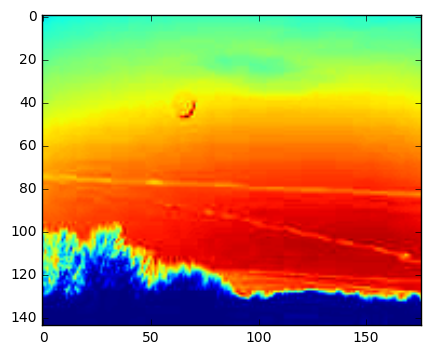

[  1.69900702e-02   1.21144564e-02   9.14438578e-03   9.81872798e-03
   1.17966371e-02   1.43354101e-02   1.05162340e-02   8.14633172e-03
   5.59719793e-03   5.63719051e-03   6.57091345e-03   9.04608914e-03
   8.30644656e-03   6.58011267e-03   4.31723122e-03   4.11660980e-03
   4.88654698e-03   6.92676914e-03   1.01651358e-02   4.95478765e-03
   3.79658606e-03   5.12866864e-03   6.19694789e-03   6.94829811e-03
   2.59440638e-03   1.41435963e-03   9.64019688e-04   1.36845845e-03
   1.39198474e-03   1.97825627e-03   1.35301046e-03   8.02375913e-04
   4.85339373e-04   5.94552173e-04   6.58357795e-04   1.02285303e-03
   1.12347733e+00   2.24695467e+00   3.37043195e+00   4.49377931e+00
   5.61743485e-01   2.80869333e-01   1.87246127e-01   1.40350267e-01
   1.87246127e-01   8.62709108e-02   2.74027667e-02   3.10381399e-03]


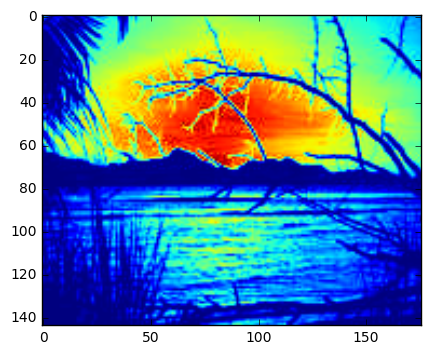

[  1.46141546e-02   1.09231968e-02   7.81070374e-03   7.46961357e-03
   8.30740113e-03   1.12413185e-02   8.27340592e-03   5.73074322e-03
   4.54629469e-03   4.75353563e-03   4.65130256e-03   5.99292851e-03
   5.36335948e-03   3.78717181e-03   3.21576879e-03   3.51133467e-03
   3.32851958e-03   4.20083257e-03   7.90047820e-03   4.79142872e-03
   3.30163200e-03   3.50731547e-03   3.56083394e-03   5.05294552e-03
   2.49577678e-03   1.37515479e-03   1.01869037e-03   1.08298761e-03
   1.05909693e-03   1.50204448e-03   1.16662121e-03   6.07188608e-04
   5.07835997e-04   6.04689336e-04   5.23192991e-04   6.80265580e-04
   1.11694845e+00   2.23389690e+00   3.35084530e+00   4.46766453e+00
   5.58474225e-01   2.79237112e-01   1.86157980e-01   1.39534647e-01
   1.86157980e-01   8.57695631e-02   2.72435205e-02   2.08985192e-03]


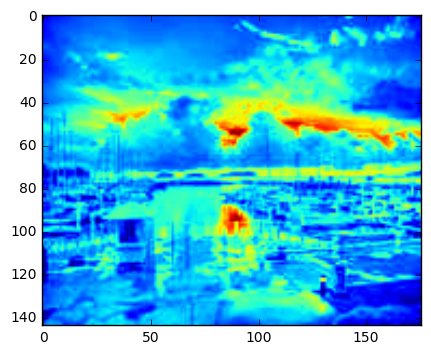

Wall time: 19min 8s


In [12]:
%%time

def get_class_features(all_images,  filter_bank):

    n_images = len(all_images)
    n_filters = filter_bank.shape[-1]
    all_feature_vectors=np.zeros((n_images,filter_bank.shape[-1]))
    
    # Complete
    for i in range(n_images):
        im = skimage.color.rgb2gray(all_images[i])
      
        im_features = features_from_filter_bank(im, filter_bank, n_filters)
        print(im_features)
        
        all_feature_vectors[i][:] = im_features
        plt.imshow(im)
        plt.show()

        
    return all_feature_vectors

all_feature_vectors=get_class_features(all_images,  filter_bank)

In [13]:
#### TODO optimize features_from_filter_bank and get_class_features code
print(all_feature_vectors)

[[ 0.02214692  0.01589003  0.01261715 ...,  0.12205312  0.03876849
   0.00305266]
 [ 0.01023255  0.00938602  0.01101112 ...,  0.16582347  0.05267154
   0.00332466]
 [ 0.01328272  0.01102356  0.01014018 ...,  0.08881482  0.02821081
   0.00247538]
 ..., 
 [ 0.00743036  0.00607134  0.00395257 ...,  0.12037549  0.03823562
   0.0028745 ]
 [ 0.01699007  0.01211446  0.00914439 ...,  0.08627091  0.02740277
   0.00310381]
 [ 0.01461415  0.0109232   0.0078107  ...,  0.08576956  0.02724352
   0.00208985]]


## Exercise 5.4 Visualizing the features of an image

Define a function `visualize_features` that given a feature index and an array containing all feature vectors, plots its values for the three datasets using different colors for each dataset (in total plots should contain 3 colors).


In [17]:
"""
def visualize_features(k, all_feature_vectors):
    # complete
    
    # 3 sets, 30 images for each set
    SETS_NUM = 3
    SET_SIZE = 30
    
    sets = { "building" : "blue","forest": "green","sunset": "red"}
    fig, ax = plt.subplots()
    
    #set number
    j = 1
    for key, value in sets.items():
        for i in range(SET_SIZE):
            n = 750
            x, y = (i, 10*all_feature_vectors[i*j][k])
            
            scale = 20.0     
            ax.scatter(x, y, c=value, label=key s=scale,edgecolors='none')
            
        j+=1

    ax.grid(True)

    plt.show()
    return None





visualize_features(25, all_feature_vectors)    
visualize_features(41, all_feature_vectors)
"""

FileNotFoundError: [Errno 2] No such file or directory: 'all_feature_vectors.npy'

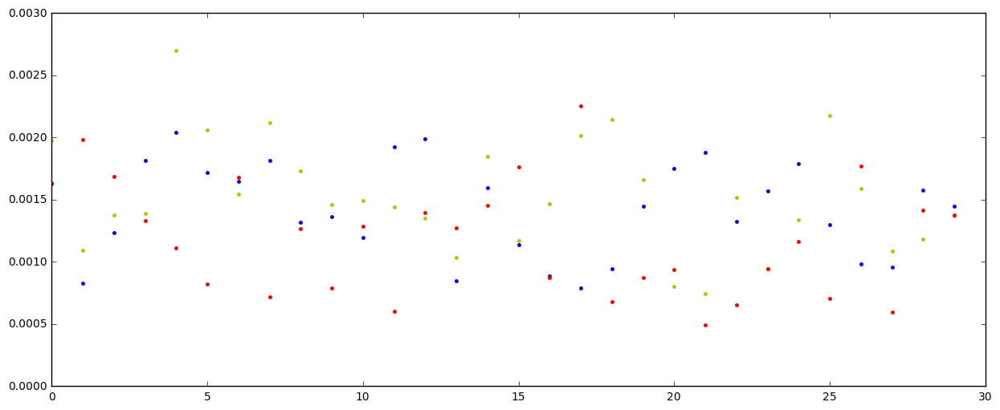

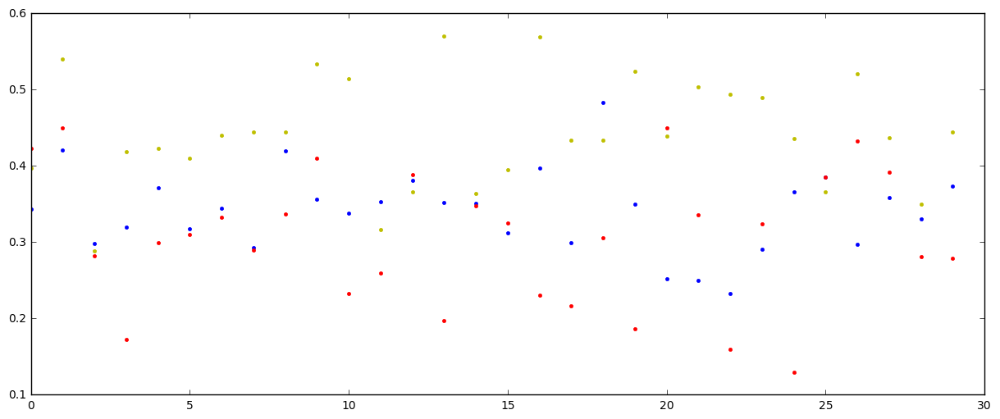

In [18]:
def visualize_features(k, all_feature_vectors):
    #We plot all the values of the feature vectors
    fig, ax = plt.subplots(ncols=1, nrows=1, figsize=(15,6))
        
    ax.plot(all_feature_vectors[0:30,k], ".y")
    ax.plot(all_feature_vectors[30:60,k], ".b")
    ax.plot(all_feature_vectors[60:90,k], ".r")
    plt.show()

visualize_features(25, all_feature_vectors)
visualize_features(41, all_feature_vectors) 





#### Similarity search

Let us assume $f(x) \in \mathbb{R}^D$ represents a set of features for $x$. Given a query image $x$ and another image $x^m$ from the database, we can compute the distance between images as
$$
\text{distance}\left( f(x) , \, f(x^m) \right) = \| \text{feat}(x)  - \text{feat}(x^m)  \|_2 =  \sqrt{ \sum_{d=1}^\text{D} \left( f(x)_d - f(x^m)_d  \right)^2 }
$$

then we can find the closest image $x^{m^*}$ from the database to $x$ as $m^* =  \text{argmin}_{m} \{ \| \text{feat}(x)  - \text{feat}(x^m)  \|_2 \}$


## Exercise 5.5 Retrieving the most similar and different images



Implement a function `retrieve_k_images_from_X(query, X, k)` where `query` is an image,  `X` ins the array containing the features from all the images and  `k` is an integer. The function should retrieve the `k` most similar and distant images (according to the l2 norm) and the distances from the closest and the furthest images to the query image. You can include the query image since it is in `X`.

- Make a plot with the first column beeing the query image and the other k columns the closest images in the feature space.

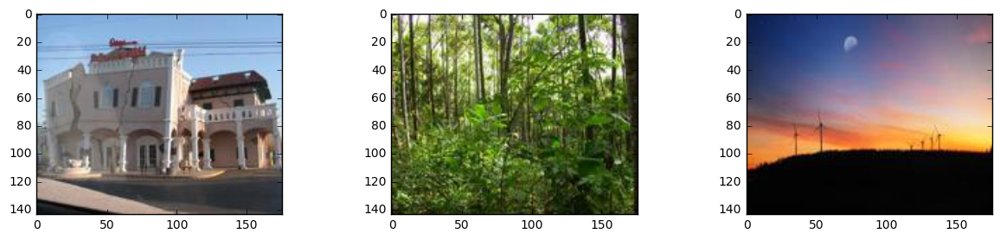

In [19]:
X = np.array(all_feature_vectors)
ind_1 = 6
ind_2 = 30
ind_3 = 65

query_1 = X[6, :]
query_2 = X[30,:]
query_3 = X[65,:]


# Display the query images
fig, ax = plt.subplots(ncols=3, nrows=1, figsize=(15,3))
ax[0].imshow(all_images[6]) 
ax[1].imshow(all_images[30])
ax[2].imshow(all_images[65])
plt.show()

In [16]:
def retrieve_k_images_from_X(query, X, k):
    #Image is converted to gray
    im = skimage.color.rgb2gray(query)
    #We obtain the features from query images
    fx = features_from_filter_bank(im, filter_bank, n_filters)

    distances = []
    closest_to_query = 0
    closest_images = 0
    
    #For each image we apply the function to construct the feature descriptor given an image
    for i in range(len(X)):
        #fx_m will be an image from the bank.
        fx_m = X[i]
        #Then, sumatori will compute the substratcion of each feature between the query image and an image i from the bank
        sumatori = 0
        for j in range(len(fx_m)-1):
            #Resta computes de difference between fx - fx_m
            resta = fx[j] - fx_m[j]
            sumatori = sumatori + (resta)**2
        #We apply the square root to the obtained value
        sumatori = math.sqrt(sumatori)
        #Value is added to the distances
        distances.append(sumatori)

    #List converted to an array
    distances = np.asarray(distances)
    #Funciton that gives us the closest image to our query
    closest_to_query = distances.argmin()
    #Function that gives us the K closest images to our query 
    closest_images = distances.argsort()[:k+1]
    
    return closest_images, distances

IndexError: index 5 is out of bounds for axis 0 with size 5

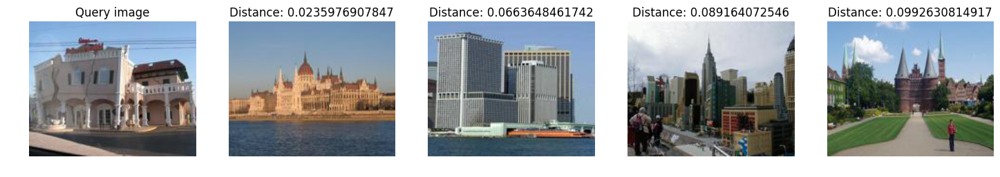

In [22]:
def show(data,k):
    #Function used to plot each set of images.
    #Data is the information given when retrieve_k_images_from_X is Used for a given image, and a K
    closest,distances = data
    fig, ax = plt.subplots(ncols=k+1, nrows=1, figsize=(18,10))
    i = 0
    #the first column is the query image and the other k columns are the closest images in the feature space as distance is
    
    for idx in closest: 
        if i == 0: 
            ax[i].set_title("Query image")
            ax[i].imshow(all_images[idx])
            ax[i].axis("off")
        else:
            ax[i].set_title("Distance: "+str(distances[idx]))
            ax[i].imshow(all_images[idx])
            ax[i].axis("off")
        i = i+1
    plt.show()
    
show(retrieve_k_images_from_X(all_images[ind_1],X,k),4)
show(retrieve_k_images_from_X(all_images[ind_2],X,k),4)
show(retrieve_k_images_from_X(all_images[ind_3],X,k),4)


## Exercise 5.6 Retrieving the most similar image based on the information about color

Based on exercises 5.3 and 5.4:
1)  Implement a function `get_rgb_Features(all_images)` that obtains the RGB information by applying `exposure.histogram(image,nbins=32)` to get a feature vector for each of the images in the union of the three datasets (forest, buildings, sunset). It must return a matrix containing at row $k$ feature vector for the input image $k$.

2)  Use the same function `retrieve_k_images_from_X(query, X, k)` where `query` is an image, `X` ins the array containing the features from all the images and  `k` is an integer. The function should retrieve the `k` most similar and distant images (according to the l2 norm) and the distances from the closest and the furthest images to the query image. You can include the query image since it is in `X`.

- And again, make a plot with the first column beeing the query image and the other k columns the closest images in the feature space.

## Exercise 5.7 Compute the accuracy of the algorithm: given a query image. 

Make a function 

```
accuracy(X, class_labels, k=5, query=x, class_query=y)
```

That takes as input a the dataset `X`, the `class_labels` for the images, the number of images to retrieve `k`, a query image `x` and the class of the query image `y`. Returns as output the number of retrieved images that belong to class `y` divided by the total of images retrieved `k` (this is the accuracy).

**Hint**: be careful to exclude the query image from the retrieved images.



- Compute the accuracy with k=4 with the previous images. Does the accuracy match the images retrieved from the previous exercise?



In [23]:
class_labels = np.concatenate((np.zeros(30), np.ones(30),  2*np.ones(30))).reshape(90,1)

In [24]:
def accuracy(X, class_labels, k, query, class_query):
    closest_images, distances = retrieve_k_images_from_X(query, X, k)
    #We erase the first image in our closest_images array as it will be the query image, the one with less distance.
    closest_images = closest_images[1:]
    accurate = 0
    
    #For each index in the closest_images array we compare the class label of the index with the given class from our query
    #if they are the same, we got +1 in our accuracy.
    for idx in closest_images:
        if class_labels[idx] == class_query:
            accurate = accurate + 1
    #Acc is obtained by dividing all accurate image by k which is the number of similar images we wanted
    acc = accurate/k
    return acc

In [25]:
k = 4
#Query images are given in gray
query1 = skimage.color.rgb2gray(all_images[ind_1])
query2 = skimage.color.rgb2gray(all_images[ind_2])
query3 = skimage.color.rgb2gray(all_images[ind_3])

#Accurracy for each ind_x is given
print("Accuracy for image 1 is: ",accuracy(X, class_labels, k, query1, class_query=class_labels[ind_1]))
print("Accuracy for image 2 is: ",accuracy(X, class_labels, k, query2, class_query=class_labels[ind_2]))
print("Accuracy for image 3 is: ",accuracy(X, class_labels, k, query3, class_query=class_labels[ind_3]))

Accuracy for image 1 is:  1.0
Accuracy for image 2 is:  0.5
Accuracy for image 3 is:  0.25


- Compute the accuracy for both cases, when X is obtained by (A) applying the bank of filters or (B) the color information.



- Compare the results obtained. Which descriptors give better performance? Can you explain why?

## Exercise 5.8 Image retrieval based on texture and color. 

Make a function ` lm_features_rgb(image, filter_bank)`  that returns the features from the filter bank concatenated per color. If the previous feature vectors had 49 components now they will have 49*3 components. 


In [26]:
def lm_features_rgb(image, filter_bank):

     #Total number of filters
    n_filters = len(filter_bank)-1
    
    #Convert each channel
    im_conv_r = np.array(image[:,:,0])
    im_conv_r = skimage.color.rgb2gray(im_conv_r)
    im_conv_g = np.array(image[:,:,1])
    im_conv_g =skimage.color.rgb2gray(im_conv_g)
    im_conv_b = np.array(image[:,:,2])
    im_conv_b =skimage.color.rgb2gray(im_conv_b)
    
    #Apply features for each channel
    features_for_im_r = features_from_filter_bank(im_conv_r, filter_bank, n_filters)
    features_for_im_g = features_from_filter_bank(im_conv_g, filter_bank, n_filters)
    features_for_im_b = features_from_filter_bank(im_conv_b, filter_bank, n_filters)
    
    #Concatenate all features
    features_for_im = np.concatenate((features_for_im_r, features_for_im_g, features_for_im_b))
    
    return features_for_im

In [27]:
%%time 
lm_rgb_features = lm_features_rgb(all_images[0], filter_bank)

Wall time: 27.5 s


## Exercise 5.9 Apply the function to all the images in the dataset

Using ` lm_features_rgb(image, filter_bank)` build the features of all the datapoints in and save them in `X_lm_rgb`.
You can parallelize the feature building process using `joblib.Parallel`. This will make the computation much faster if you have a processor with more than two threads.

In [ ]:
def get_class_features_rgb(all_images, filter_bank):

    n_images = len(all_images)
    X_lm_rgb=np.zeros((n_images,filter_bank.shape[-1]*3))
        
    #For each image we apply the function to construct the feature descriptor given a RGB image
    for i in range(n_images):
        #We apply the feature descriptor function
        X_lm_rgb[i] = lm_features_rgb(all_images[i], filter_bank)
    return X_lm_rgb
    
    
X_lm_rgb = get_class_features_rgb(all_images,filter_bank)

KeyboardInterrupt: 

## 5.10 Compute the accuracy of the method using lm rgb features

Use the function implemented in 5.6 to compute the accuracy of the retrieved images using the features that contain color information. Make a plot of the 4 closest images to the query images in the `lm_rgb` space.

- Is the accuracy higher?

In [31]:
# compute (X_lm_rgb) and cast it as array
X_lm_rgb = np.array(X_lm_rgb)

NameError: name 'X_lm_rgb' is not defined

In [32]:
def retrieve_k_images_from_X_RGB(query, X, k):    
    #Image is converted to gray
    im = skimage.color.rgb2gray(query)
    #We obtain the features from query images
    fx = lm_features_rgb(query, filter_bank)
    
    distances = []
    closest_to_query = 0
    closest_images = 0
    
    #For each image we apply the function to construct the feature descriptor given an image
    for i in range(len(X)):
        #fx_m will be an image from the bank.
        fx_m = X[i]
        #Then, sumatori will compute the substratcion of each feature between the query image and an image i from the bank
        sumatori = 0
        for j in range(len(fx_m)-1):
            resta = fx[j] - fx_m[j]
            sumatori = sumatori + (resta)**2
        #We apply the square root to the obtained value
        sumatori = math.sqrt(sumatori)
        #Value is added to the distances
        distances.append(sumatori)

    #List converted to an array
    distances = np.asarray(distances)
    #Funciton that gives us the closest image to our query
    closest_to_query = distances.argmin()
    #Function that gives us the K closest images to our query 
    closest_images = distances.argsort()[:k+1]
    
    return closest_images, distances

show(retrieve_k_images_from_X_RGB(all_images[ind_1],X_lm_rgb,k),4)
show(retrieve_k_images_from_X_RGB(all_images[ind_2],X_lm_rgb,k),4)
show(retrieve_k_images_from_X_RGB(all_images[ind_3],X_lm_rgb,k),4)

NameError: name 'X_lm_rgb' is not defined